<center>
<h2> <strong>Graphs in Machine Learning</strong> <br/>
Assignment 1: <strong> Spectral Clustering </strong>
</h2>
<hr>
<strong> Ben KABONGO B. </strong><br/>
M2 MVA, ENS Paris-Saclay<br/>
<i>ben.kabongo_buzangu@ens-paris-saclay.fr</i>
<hr>
</center>

In this exercise, you will implement spectral clustering and try it on diffent kinds of data, for instance:

* N-blob: Random points in $\mathbb{R}^2$ according to N Gaussian distributions with different means;

* Two moons: Random points shaped as two intertwined moons; 

* Point and circle: random points from a concentrated Gaussian point in the middle and a wide circle around it.

The first step after generating the data is to construct a graph and, for that, we need a similarity function. In this exercise we will use the following similarity:

$$
d(x_i, x_j) = \exp\left(-\frac{||x_i-x_j||_2^2}{2\sigma^2}\right)
$$

Using this similarity, we can compute the weight matrix W representing the graph, compute the graph Laplacian L and finally use its eigenvectors for clustering.

## Setup

In [1]:
import matplotlib.pyplot as plt
import numpy as np
import os
import scipy.linalg
import sklearn.metrics as skm
import warnings

from skimage import io
from sklearn.cluster import KMeans
from sklearn.metrics.pairwise import euclidean_distances

from generate_data import worst_case_blob, blobs, two_moons, point_and_circle
from utils import plot_clusters, min_span_tree, plot_graph_matrix, min_span_tree, plot_edges_and_points
from utils import plot_clustering_result, plot_the_bend

In [2]:
warnings.filterwarnings(action="ignore")

## Generating the data

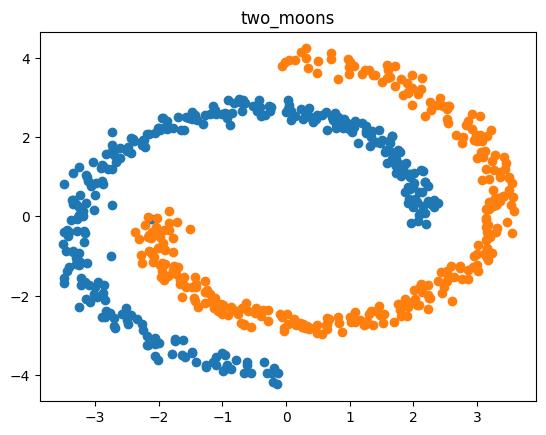

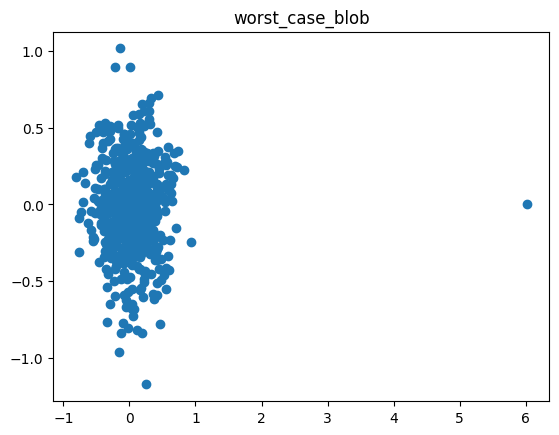

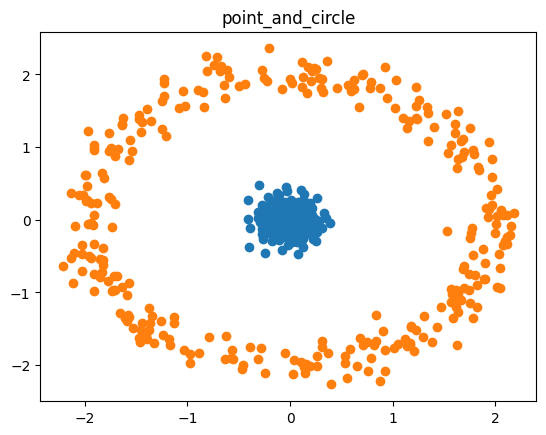

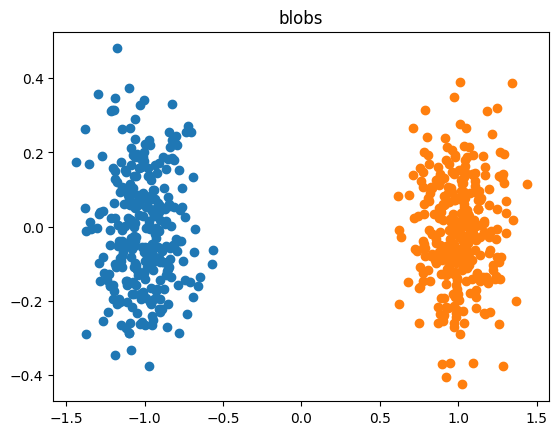

In [3]:
for fn in [two_moons, worst_case_blob, point_and_circle, blobs]:
    X, Y = fn(num_samples=600)
    plot_clusters(X, Y, fignum=str(fn), show=False)
    plt.title(str(fn.__name__))
    plt.show()

### Back to the exponential function

> The exponential function has definition domain $\mathbb{R}$ and image domain $\mathbb{R}^*_+$.

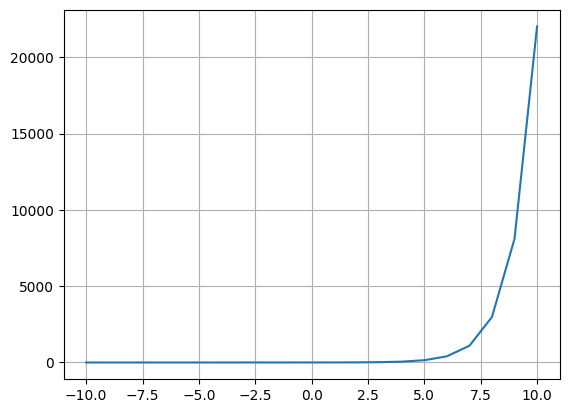

In [4]:
x = np.arange(-10, +11)
plt.plot(x, np.exp(x))
plt.grid(True)
plt.show()

> Note that the exponential function is bounded at 1 for negative or zero real numbers.

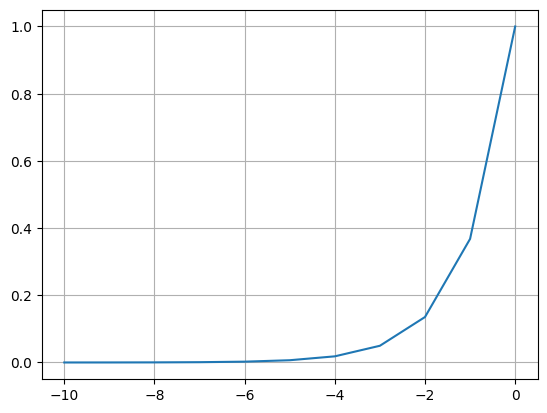

In [5]:
x = np.arange(-10, 1)
plt.plot(x, np.exp(x))
plt.grid(True)
plt.show()

> We use a similarity function whose argument is in $\mathbb{R}_-$.

> It's very important to note that the notion of distance and similarity are in this case the opposite of each other. For example, a point's Euclidean distance from itself will be 0, and its similarity will be 1. So in future, if we use the similarity function as a distance, we'll have to take this subtlety into account.

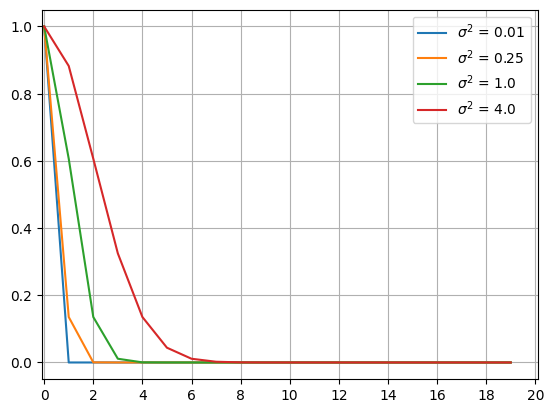

In [6]:
x = np.arange(20)
for var in [0.01, 0.25, 1.0, 4.0]:
    plt.plot(x, np.exp(-x**2/(2*var)), label=f"$\sigma^2$ = {var}")
plt.legend()
plt.xticks(np.arange(0, 21, 2))
plt.xlim(-0.1, 20.1)
plt.grid(True)
plt.show()

## Building similarity graph

In [7]:
def build_similarity_graph(X, var=1.0, eps=0.0, k=0, knn_or=True):
    """
    Computes the similarity matrix for a given dataset of samples. 
    If k=0, builds epsilon graph. 
    Otherwise, builds kNN graph.

    Parameters
    ----------
    X : numpy array
        (n x m) matrix of m-dimensional samples
    var : double 
        the sigma value for the exponential function, already squared
    eps : double
        threshold for epsilon graphs
    k : int
        The number of neighbours k for k-nn. If zero, use epsilon-graph
    knn_or : boolean
        k-nn type. If True, use k-nn or. Else, use knn-and

    Returns
    -------
        W: (n x n) dimensional matrix representing the weight matrix of the graph
    """
    n = X.shape[0]
    W = np.zeros((n, n))

    """
    Build similarity graph, before threshold or kNN
    similarities: (n x n) matrix with similarities between all possible couples of points.
    The similarity function is d(x,y)=exp(-||x-y||^2/(2*var))
    """
    similarities = np.exp(- (euclidean_distances(X) ** 2) / (2 * var))
    similarities[np.arange(n), np.arange(n)] = 0

    # If epsilon graph
    if k == 0:
        """
        compute an epsilon graph from the similarities             
        for each node x_i, an epsilon graph has weights             
        w_ij = d(x_i,x_j) when w_ij >= eps, and 0 otherwise          
        """
        W = similarities
        W[W < eps] = 0 # < (instead of >=) to keep the most similar elements

    # If kNN graph
    elif k != 0:
        """
        compute a k-nn graph from the similarities                   
        for each node x_i, a k-nn graph has weights                  
        w_ij = d(x_i,x_j) for the k closest nodes to x_i, and 0     
        for all the k-n remaining nodes                              
        Remember to remove self similarity and                       
        make the graph undirected                                    
        """
        for i in range(n):

            k_neighbors_indices = np.argsort(-similarities[i])[:k]

            if knn_or:
                for j in k_neighbors_indices:
                    W[i, j] = similarities[i, j]
                    W[j, i] = similarities[i, j]

            else:
                for j in k_neighbors_indices:
                    if i in np.argsort(-similarities[j])[:k]:
                        W[i, j] = similarities[i, j]
                        W[j, i] = similarities[i, j]
            
    return W

In [8]:
X, Y = two_moons(num_samples=600)

Epsilon graph


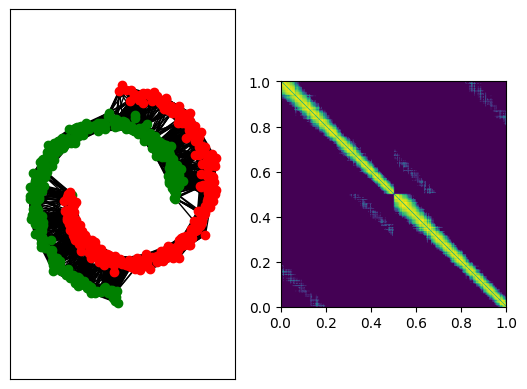

K-NN OR graph


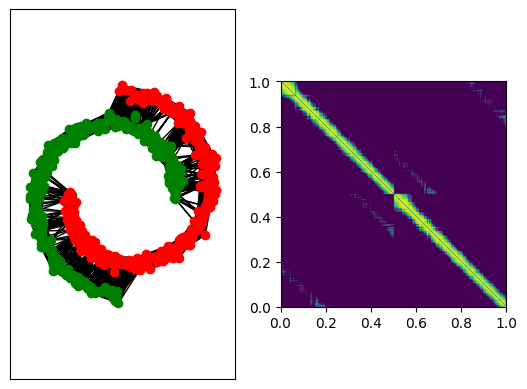

K-NN AND graph


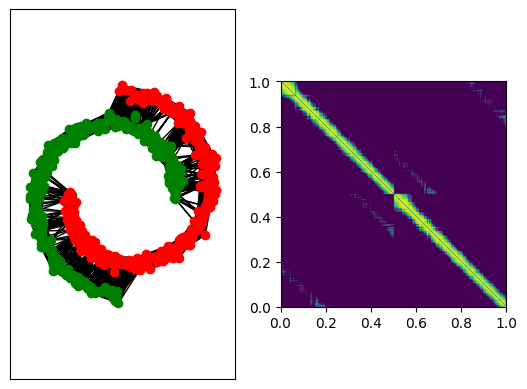

In [9]:
print("Epsilon graph")
W = build_similarity_graph(X, eps=0.5)
plot_graph_matrix(X, Y, W)

print("K-NN OR graph")
W = build_similarity_graph(X, k=40, knn_or=True)
plot_graph_matrix(X, Y, W)

print("K-NN AND graph")
W = build_similarity_graph(X, k=40, knn_or=True)
plot_graph_matrix(X, Y, W)

## Computing the Laplacian

In [10]:
def build_laplacian(W, laplacian_normalization='unn'):
    """
    Compute graph Laplacian.

    Parameters
    ----------
    W : numpy array
        Adjacency matrix (n x n)
    laplacian_normalization : str
        String selecting which version of the laplacian matrix to construct.
            'unn':  unnormalized,
            'sym': symmetric normalization
            'rw':  random-walk normalization   

    Returns
    -------
    L: (n x n) dimensional matrix representing the Laplacian of the graph
    """
    D = np.diag(W.sum(axis=1))
    L = D - W

    if laplacian_normalization == "sym":
        D_inv_sqrt = np.sqrt(np.linalg.pinv(D))
        L = D_inv_sqrt.dot(L).dot(D_inv_sqrt)

    elif laplacian_normalization == "rw":
        D_inv = np.linalg.pinv(D)
        L = D_inv.dot(L)

    return L

## Clustering

In [11]:
def spectral_clustering(L, chosen_eig_indices=None, num_classes=2):
    """
    Parameters
    ----------
    L : numpy array
        Graph Laplacian (standard or normalized)
    choosen_eig_indices : list or None
        Indices of eigenvectors to use for clustering. 
        If None, use adaptive choice of eigenvectors.
    num_classes : int 
        Number of clusters to compute (defaults to 2)


    Returns
    -------
    Y : numpy array (num_samples, )
        Cluster assignments
    """

    """
    Use the function scipy.linalg.eig or the function scipy.sparse.linalg.eigs to compute:
    U = (n x n) eigenvector matrix           (sorted)
    E = (n x n) eigenvalue diagonal matrix   (sorted)
    """
    eig_values, eig_vectors = scipy.linalg.eig(L)
    argsort = np.argsort(eig_values)
    E = np.diag(eig_values[argsort].real)
    U = eig_vectors[:, argsort].real

    """
    compute the clustering assignment from the eigenvectors        
    Y = (n x 1) cluster assignments in [0,1,...,num_classes-1]                   
    """
    if chosen_eig_indices is None:
        eig_values /= eig_values.sum()
        idx = np.sum(np.cumsum(eig_values) < 1e-5)
        if idx <= 1: idx = 2
        chosen_eig_indices = np.arange(1, idx)
    
    U = U[:, chosen_eig_indices]
    Y = KMeans(n_clusters=num_classes).fit_predict(U)
    return Y

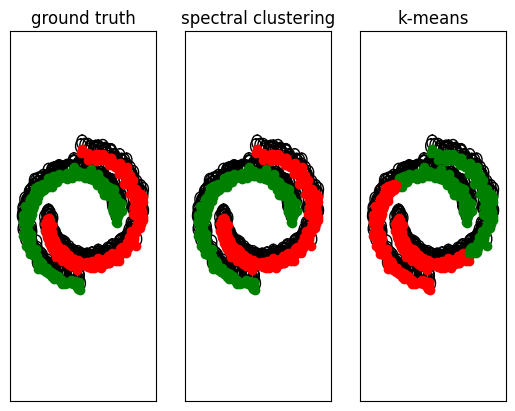

In [12]:
num_classes = 2
W = build_similarity_graph(X, eps=0.8)
L = build_laplacian(W)
Y_rec = spectral_clustering(L, chosen_eig_indices=None, num_classes=num_classes)
plot_clustering_result(X, Y, L, Y_rec, KMeans(num_classes).fit_predict(X))

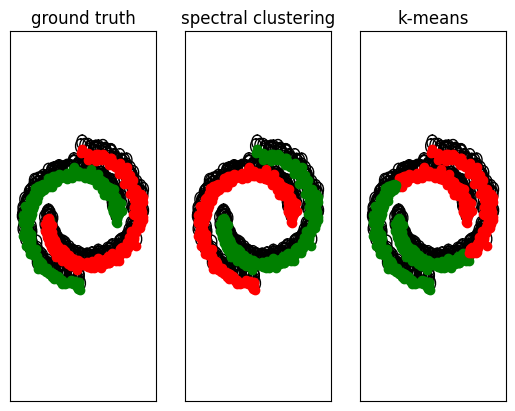

In [13]:
num_classes = 2
W = build_similarity_graph(X, eps=0.8)
L = build_laplacian(W)
Y_rec = spectral_clustering(L, chosen_eig_indices=[1], num_classes=num_classes)
plot_clustering_result(X, Y, L, Y_rec, KMeans(num_classes).fit_predict(X))

In [14]:
def clustering_and_plot(X, Y, W, laplacian_normalization='rw', chosen_eig_indices=None, num_classes=2, verbose=True):
    L = build_laplacian(W, laplacian_normalization)
    spectral_labels = spectral_clustering(L, chosen_eig_indices, num_classes)
    kmeans_labels = KMeans(num_classes).fit_predict(X)
    
    if verbose:
        plt.figure(figsize=(20, 5))
        plt.clf()
        plt.subplot(1, 4, 1)
        plot_edges_and_points(X,Y,W)
        plt.subplot(1, 4, 2)
        plt.imshow(W, extent=[0, 1, 0, 1])
        plt.subplot(1, 4, 3)
        plot_edges_and_points(X, spectral_labels, W, 'spectral clustering')
        plt.subplot(1, 4, 4)
        plot_edges_and_points(X, kmeans_labels, W, 'k-means')
        plt.show()

    spectral_score = skm.adjusted_rand_score(Y, spectral_labels)
    kmeans_score = skm.adjusted_rand_score(Y, kmeans_labels)
    
    return spectral_score, kmeans_score

## Parameter sensitivity 

In [15]:
def parameter_sensitivity():
    """
    A function to test spectral clustering sensitivity to parameter choice.
    """
    # the number of samples to generate
    num_samples = 500

    # Generate data
    X, Y = two_moons(num_samples, 1, 0.02)
    num_classes = len(np.unique(Y))

    chosen_eig_indices = [1]
    var = 1.0  # exponential_euclidean's sigma^2

    # evaluate function
    def evaluate(parameters, laplacian_normalization):
        W = build_similarity_graph(X, **parameters)
        L = build_laplacian(W, laplacian_normalization)
        Y_rec = spectral_clustering(L, chosen_eig_indices, num_classes)
        score = skm.adjusted_rand_score(Y, Y_rec)
        return score

    all_eps = [0.5, 0.6, 0.7, 0.8, 0.9]
    all_k = [1, 2, 3, 4, 5, 10, 15, 20, 25, 30, 40, 50, 60, 70]

    scores = {}

    # Epsilon - graph
    scores["eps"] = {}
    for laplacian_normalization in ["unn", "sym", "rw"]:
        scores["eps"][laplacian_normalization] = {}
        for eps in all_eps:
            scores["eps"][laplacian_normalization][eps] = evaluate({"eps": eps, "var": var}, laplacian_normalization)
    plt.figure()
    for laplacian_normalization in ["unn", "sym", "rw"]:
        plt.plot(np.arange(len(all_eps)), 
                list(scores["eps"][laplacian_normalization].values()),
                label=laplacian_normalization)
    plt.title(f'Epsilon graph')
    plt.xticks(np.arange(len(all_eps)), np.round(all_eps, 1))
    plt.grid(True)
    plt.legend()
    plt.show()

    # KNN or - graph
    scores["knn-or"] = {}
    for laplacian_normalization in ["unn", "sym", "rw"]:
        scores["knn-or"][laplacian_normalization] = {}
        for k in all_k:
            scores["knn-or"][laplacian_normalization][k] = evaluate({"k": k, "var": var, "knn_or": True}, laplacian_normalization)
    plt.figure()
    for laplacian_normalization in ["unn", "sym", "rw"]:
        plt.plot(np.arange(len(all_k)), 
                list(scores["knn-or"][laplacian_normalization].values()),
                label=laplacian_normalization)
    plt.title(f'KNN or graph')
    plt.xticks(np.arange(len(all_k)), all_k)
    plt.grid(True)
    plt.legend()
    plt.show()

    # KNN and - graph
    scores["knn-and"] = {}
    for laplacian_normalization in ["unn", "sym", "rw"]:
        scores["knn-and"][laplacian_normalization] = {}
        for k in all_k:
            scores["knn-and"][laplacian_normalization][k] = evaluate({"k": k, "var": var, "knn_or": False}, laplacian_normalization)
    plt.figure()
    for laplacian_normalization in ["unn", "sym", "rw"]:
        plt.plot(np.arange(len(all_k)), 
                list(scores["knn-and"][laplacian_normalization].values()),
                label=laplacian_normalization)
    plt.title(f'KNN and graph')
    plt.xticks(np.arange(len(all_k)), all_k)
    plt.grid(True)
    plt.legend()
    plt.show()

    return scores

## Image segmentation

In [16]:
def image_segmentation(
        input_img='four_elements.bmp',
        eps=0.5, var=1, k=20, knn_or=True,
        laplacian_normalization='unn', 
        num_classes=4, chosen_eig_indices=None
    ):
    """
    Function to perform image segmentation.
    :param input_img: name of the image file in /data (e.g. 'four_elements.bmp' or 'fruit_salad.bmp')
    """
    filename = os.path.join('data', input_img)

    X = io.imread(filename)
    X = (X - np.min(X)) / (np.max(X) - np.min(X))

    im_side = np.size(X, 1)
    Xr = X.reshape(im_side ** 2, 3)
    """
    Y_rec should contain an index from 0 to c-1 where c is the     
     number of segments you want to split the image into          
    """

    W = build_similarity_graph(Xr, var=var, eps= eps, k=k, knn_or=knn_or)
    L = build_laplacian(W, laplacian_normalization)
    Y_rec = spectral_clustering(L, chosen_eig_indices, num_classes=num_classes)
    Y_rec = Y_rec.reshape(im_side, im_side)

    plt.figure()
    plt.subplot(1, 2, 1)
    plt.imshow(X)
    plt.axis("off")
    plt.subplot(1, 2, 2)
    plt.imshow(Y_rec)
    plt.axis("off")
    plt.show()

# Questions

### Q1.1: What is the purpose of the option parameter in `worst_case_blob`?

> The `delta` parameter in the `worst_case_blob` function is used to introduce an outliner into the data generated by the function. The larger the delta value, the further the outliner is from the generated data. When the distance is small, the outliner is very close to the other data and hardly distinguishable from it. When the distance is large, the outliner is easily distinguishable from the other data.

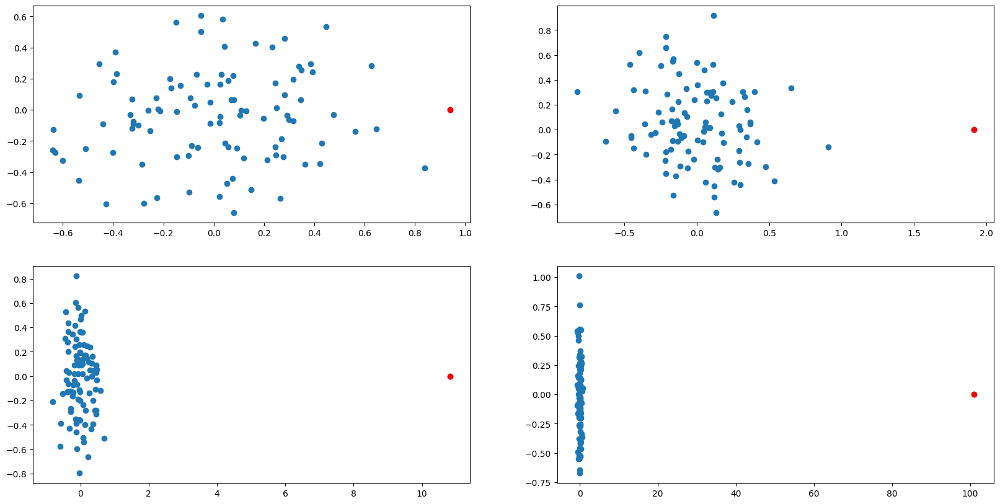

In [17]:
plt.figure(figsize=(20, 10))
for i, delta in enumerate([0.1, 1, 10, 100]):
    X, Y = worst_case_blob(100, delta)
    plt.subplot(2, 2, i + 1)
    for y in np.unique(Y):
        plt.scatter(X[Y == y, 0], X[Y == y, 1], marker='o')
    plt.scatter(X[-1, 0], X[-1, 1], marker='o', color="red")
plt.show()

### Q1.2: While varying the parameter of `worst_case_blob`, try to select a value of $\epsilon$ that keeps the graph connected (the function `min_span_tree` can help you). What happens? Can you tell when it is a bad idea to use this approach?

> Given a (non-oriented) weighted graph, its minimum spanning tree is the tree of minimum weight obtained by deleting certain edges while keeping the graph connected. In our case, the weights are represented by the similarities, and we want to keep the edges with the highest similarity. To find the spanning tree of the completely connected graph, we'll use the opposite of the $W$ matrix.

> We vary $delta$ from 0.4 to 2.0 in steps of 0.4. For each value of $delta$, we begin by calculating the similarity matrix of the complete graph. Then, to find the $\epsilon$ threshold that keeps the graph connected, we calculate the minimum spanning tree, which retains the greatest similarities while transforming the graph into a tree, and find the minimum similarity in the minimum spanning tree obtained. This minimum similarity gives us the threshold below which the graph is no longer connected.

> For each value of $delta$, we calculate the ratio between the number of edges in the $\epsilon$ graph and the number of edges in the complete graph. We find that this ratio is very large for small delta values, but becomes very small for large delta values. Also, the $\epsilon$ threshold includes smaller and smaller similarities as delta increases. The resulting graph is not very far from the full graph, in terms of number of edges. We conclude that the method becomes ineffective with large values of $delta$.

Delta = 0.4
	Eps = 0.8990634868841203
	#Edges - fully connected = 124750
	#Edges - epsilon graph = 56443
	Ratio = 54.76%
	Fully connected - delta = 0.4


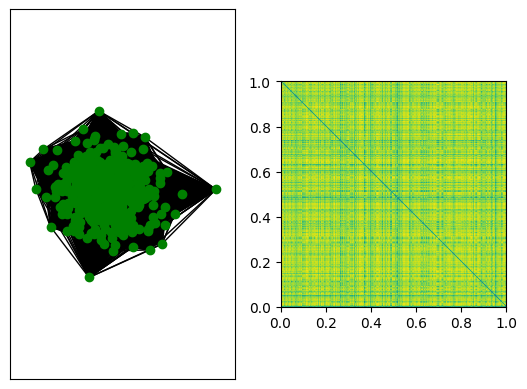

	Espilon graph - delta = 0.4


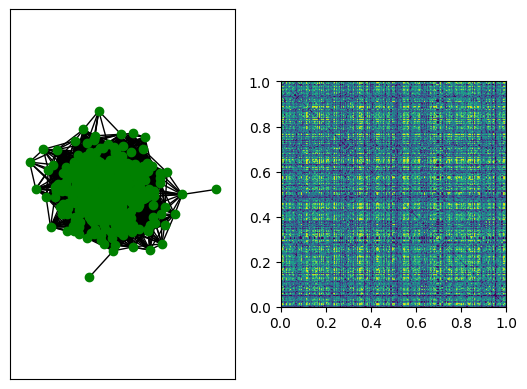

Delta = 0.8
	Eps = 0.7245334533363824
	#Edges - fully connected = 124750
	#Edges - epsilon graph = 102304
	Ratio = 17.99%
	Fully connected - delta = 0.8


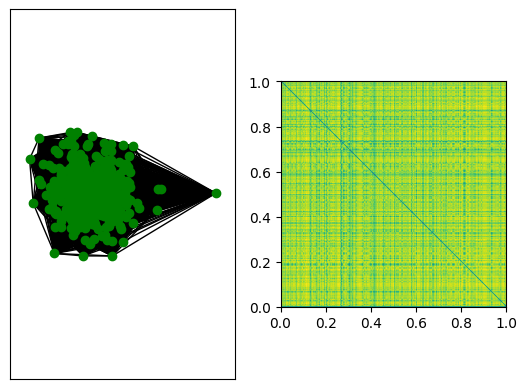

	Espilon graph - delta = 0.8


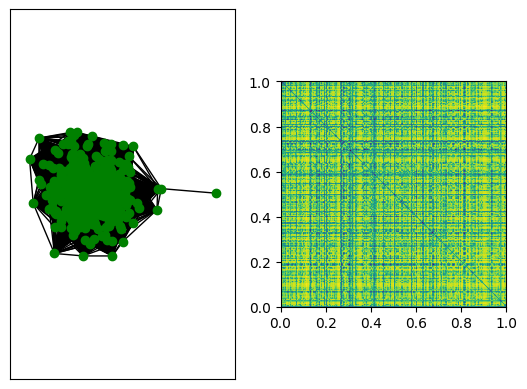

Delta = 1.2000000000000002
	Eps = 0.4701429437562789
	#Edges - fully connected = 124750
	#Edges - epsilon graph = 122232
	Ratio = 2.02%
	Fully connected - delta = 1.2


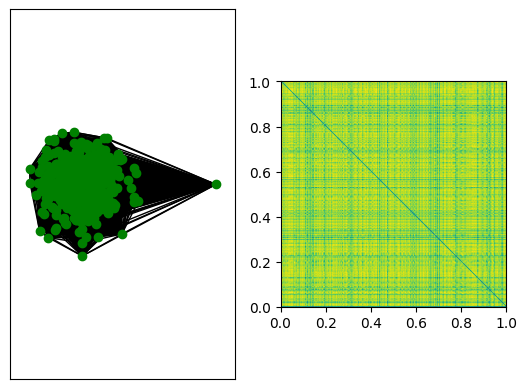

	Espilon graph - delta = 1.2


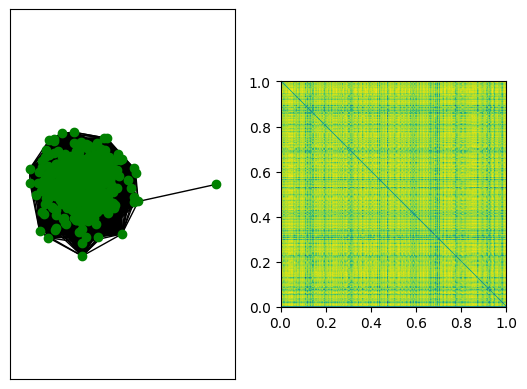

Delta = 1.6
	Eps = 0.2315040750547423
	#Edges - fully connected = 124750
	#Edges - epsilon graph = 124224
	Ratio = 0.42%
	Fully connected - delta = 1.6


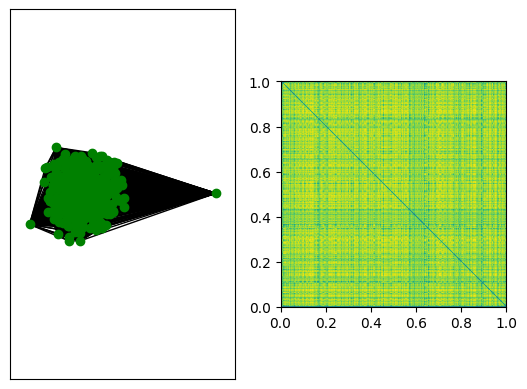

	Espilon graph - delta = 1.6


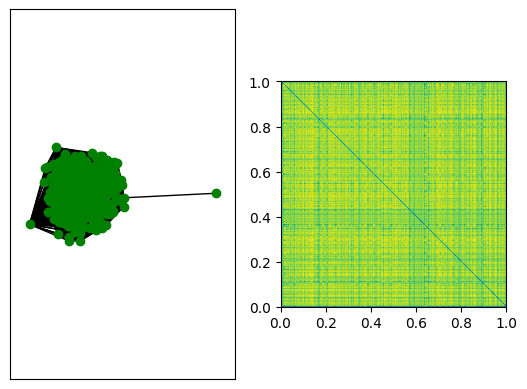

Delta = 2.0
	Eps = 0.0954614761102994
	#Edges - fully connected = 124750
	#Edges - epsilon graph = 124252
	Ratio = 0.40%
	Fully connected - delta = 2.0


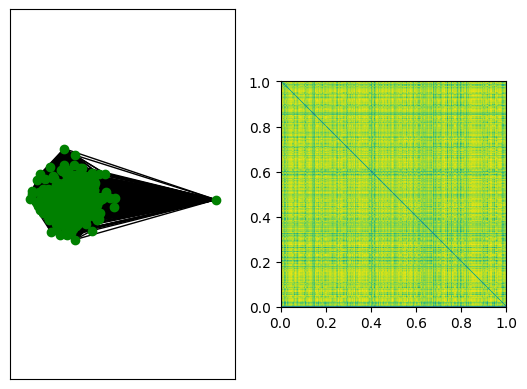

	Espilon graph - delta = 2.0


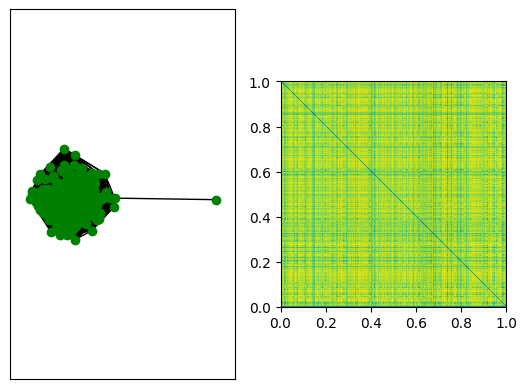

In [18]:
ratios = []
epss = []
deltas = np.arange(0.4, 2.1, 0.4)

for delta in deltas:
    X, Y = worst_case_blob(500, delta)
    W = build_similarity_graph(X, var=1, eps=0)

    T = min_span_tree(-W) 
    TW = T * W
    eps = TW[np.nonzero((TW))].min()
    new_W = build_similarity_graph(X, var=1, eps=eps)

    print(f"Delta = {delta}")
    print(f"\tEps = {eps}")
    nb_edges_fc = np.count_nonzero(W) // 2
    nb_edges_eg = np.count_nonzero(new_W) // 2
    ratio = ((nb_edges_fc - nb_edges_eg) / nb_edges_fc) * 100
    print(f"\t#Edges - fully connected = {nb_edges_fc}")
    print(f"\t#Edges - epsilon graph = {nb_edges_eg}")
    print(f"\tRatio = {ratio:.2f}%")

    print(f"\tFully connected - delta = {delta:.1f}")
    plot_graph_matrix(X, Y, W, f"Fully connected - delta = {delta}")
    print(f"\tEspilon graph - delta = {delta:.1f}")
    plot_graph_matrix(X, Y, new_W, f"Espilon graph - delta = {delta}")

    ratios.append(ratio)
    epss.append(eps)

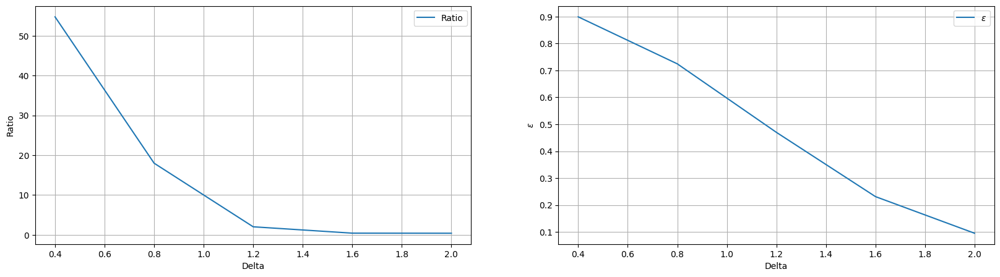

In [19]:
plt.figure(figsize=(20, 5))
plt.subplot(1, 2, 1)
plt.plot(deltas, ratios, label="Ratio")
plt.xlabel("Delta")
plt.ylabel("Ratio")
plt.grid(True)
plt.legend()
plt.subplot(1, 2, 2)
plt.plot(deltas, epss, label="$\epsilon$")
plt.xlabel("Delta")
plt.ylabel("$\epsilon$")
plt.grid(True)
plt.legend()
plt.show()

### Q1.3: Is it important to build a connected graph? Compare k-NN to $\epsilon$-graphs with respect to the difficulty of building a connected graph.

> Building a connected graph is often important in various applications, such as clustering. A connected graph ensures that every node in the graph is reachable from every other node.

> While k-NN graphs can provide local connections and capture local structure well, they may not guarantee global connectivity. There might be isolated clusters of nodes that are not connected to the main graph. Building a connected k-NN graph can be challenging, especially when the underlying data has complex structures, such as disjoint clusters or outliers. Adjusting the value of k can impact the connectivity, but finding an optimal value is often non-trivial.

> $\epsilon$-graphs tend to provide better global connectivity, as nodes are connected based on a distance threshold. They can capture both local and global structures in the data. Building a connected $\epsilon$-graph is generally more straightforward than ensuring connectivity in k-NN graphs. However, choosing an appropriate $\epsilon$ value is crucial. A large $\epsilon$ may lead to a sparse graph with disconnected components, while a small $\epsilon$ may result in a fully connected graph that loses local details.

two_moons - Epsilon graph - eps = 0.1


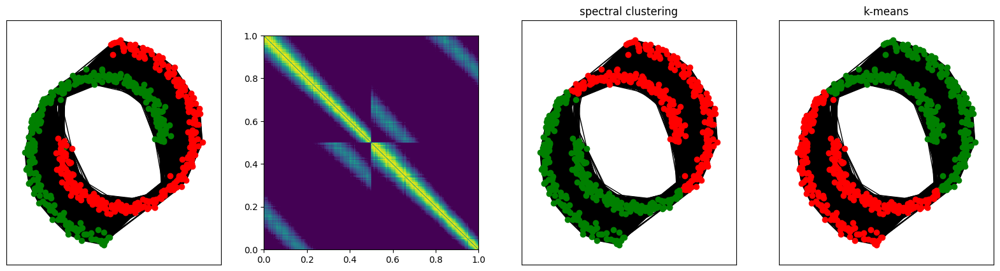

two_moons - Epsilon graph - eps = 0.5


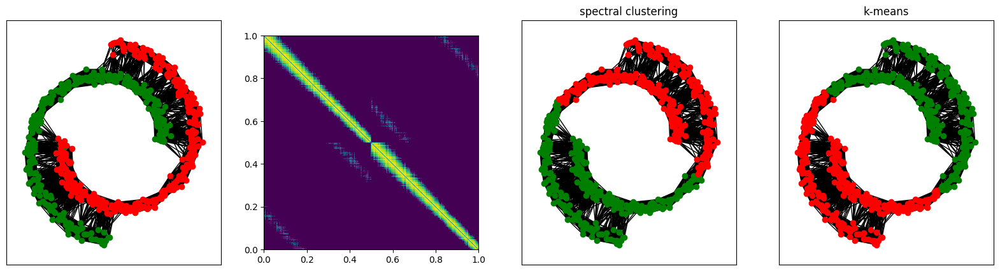

two_moons - Epsilon graph - eps = 0.9


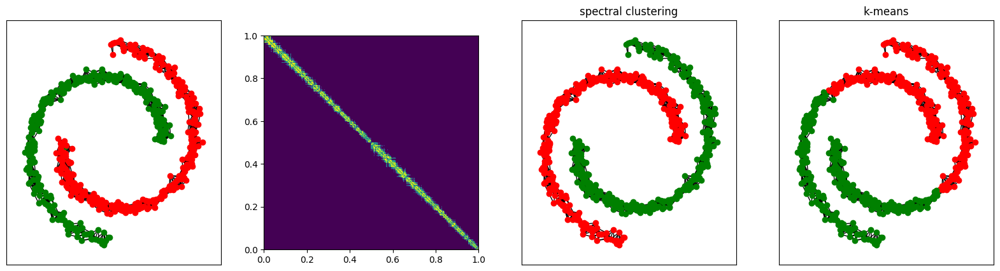

two_moons - KNN OR graph - k = 10


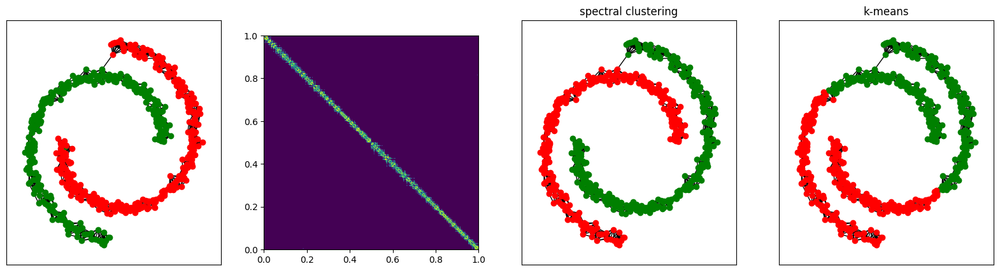

two_moons - KNN OR graph - k = 50


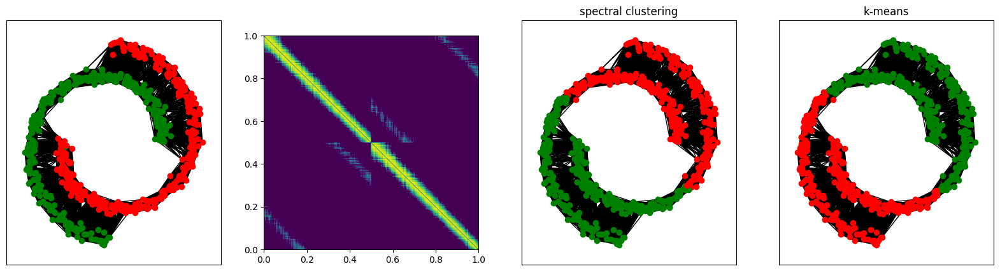

two_moons - KNN OR graph - k = 100


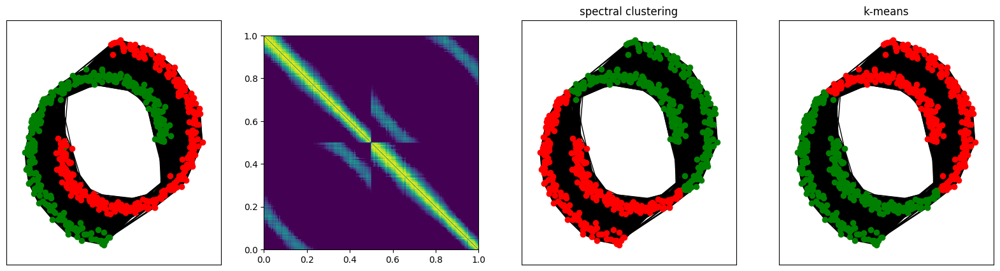

two_moons - KNN AND graph - k = 10


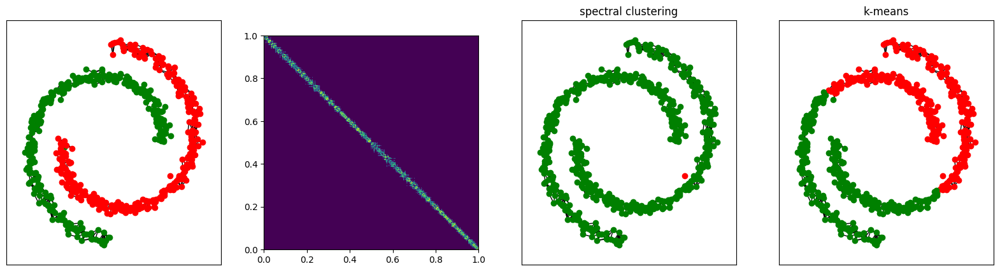

two_moons - KNN AND graph - k = 50


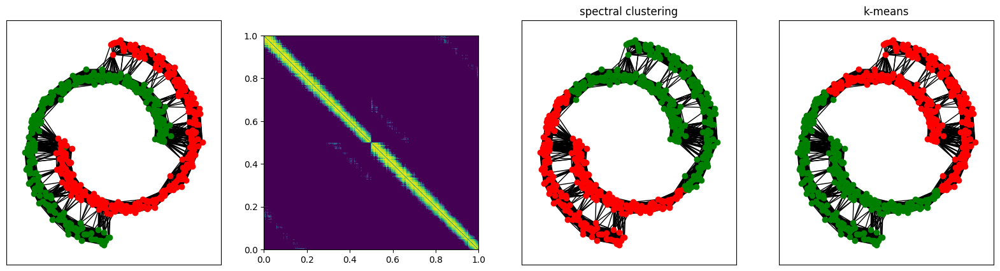

two_moons - KNN AND graph - k = 100


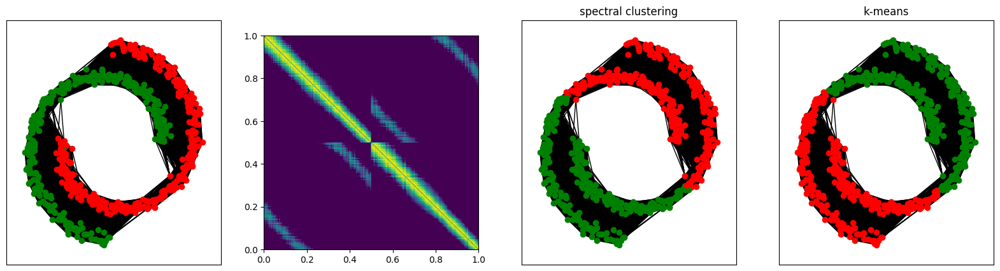

worst_case_blob - Epsilon graph - eps = 0.1


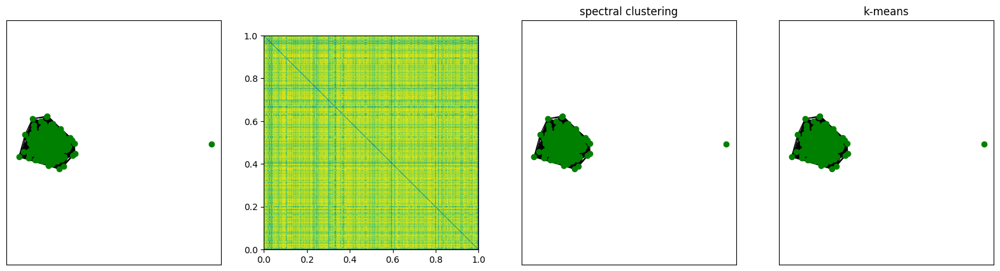

worst_case_blob - Epsilon graph - eps = 0.5


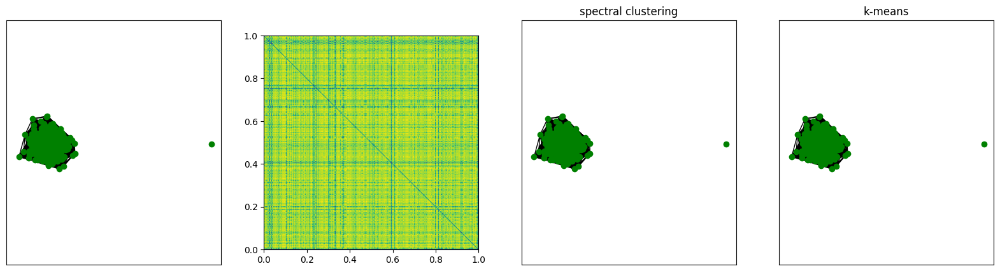

worst_case_blob - Epsilon graph - eps = 0.9


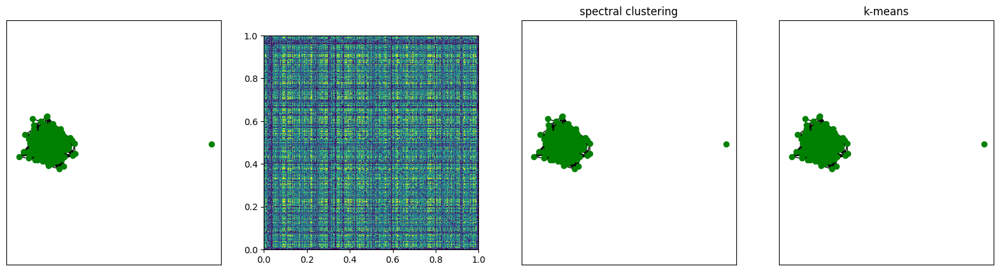

worst_case_blob - KNN OR graph - k = 10


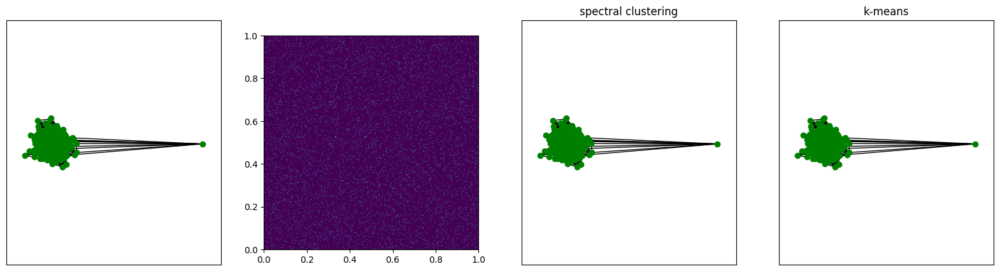

worst_case_blob - KNN OR graph - k = 50


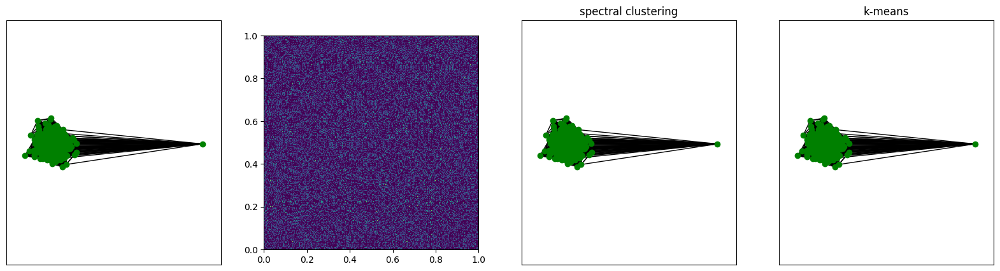

worst_case_blob - KNN OR graph - k = 100


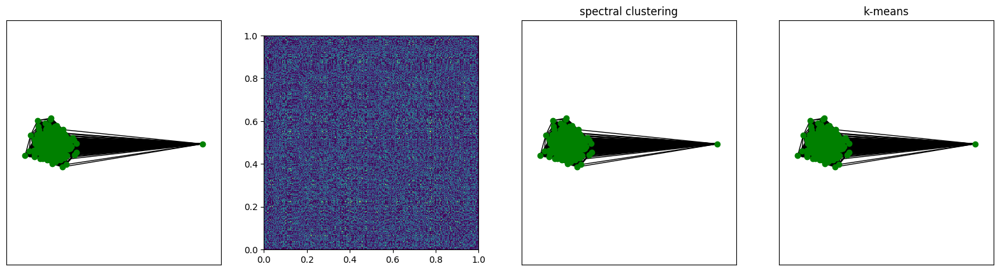

worst_case_blob - KNN AND graph - k = 10


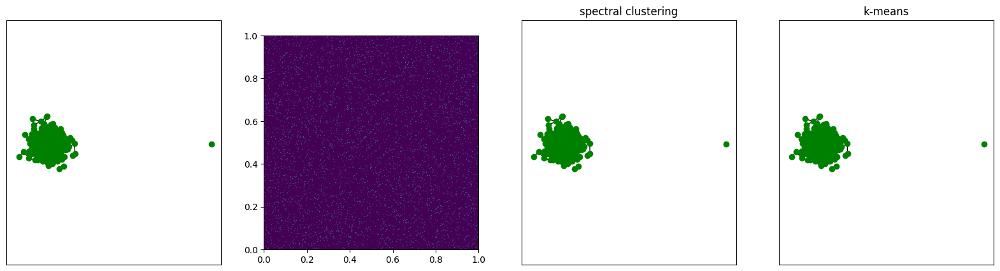

worst_case_blob - KNN AND graph - k = 50


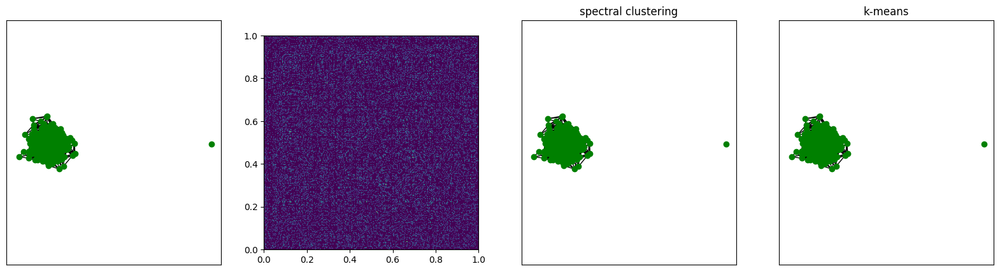

worst_case_blob - KNN AND graph - k = 100


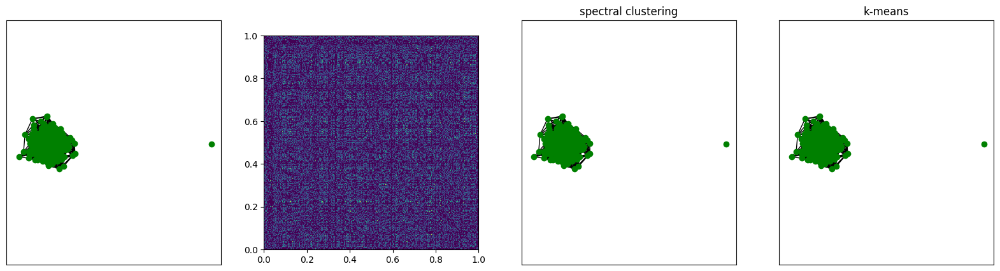

point_and_circle - Epsilon graph - eps = 0.1


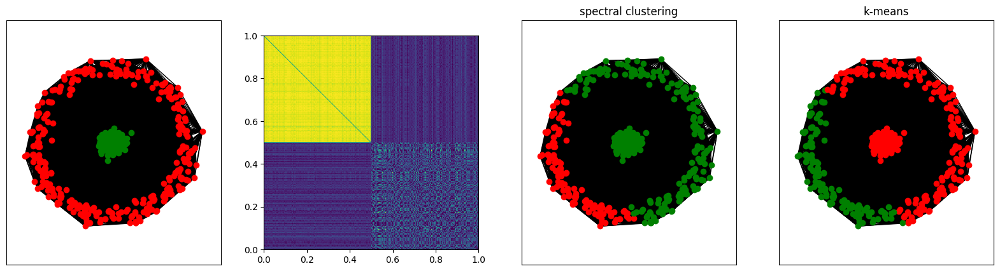

point_and_circle - Epsilon graph - eps = 0.5


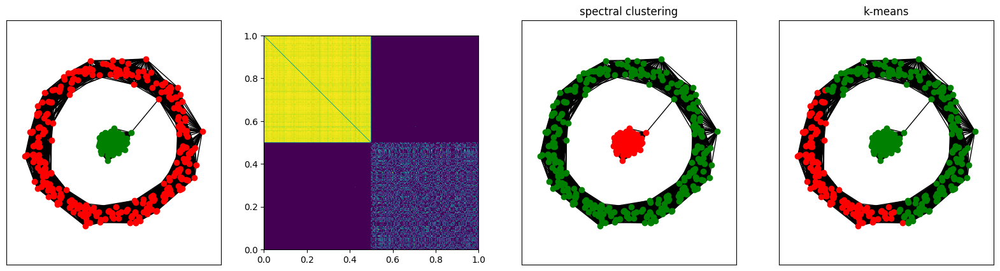

point_and_circle - Epsilon graph - eps = 0.9


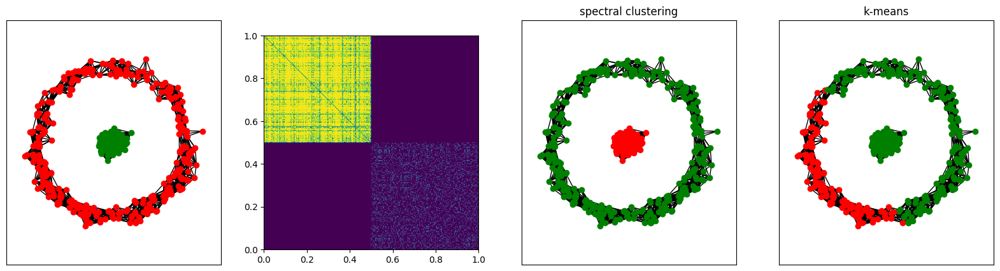

point_and_circle - KNN OR graph - k = 10


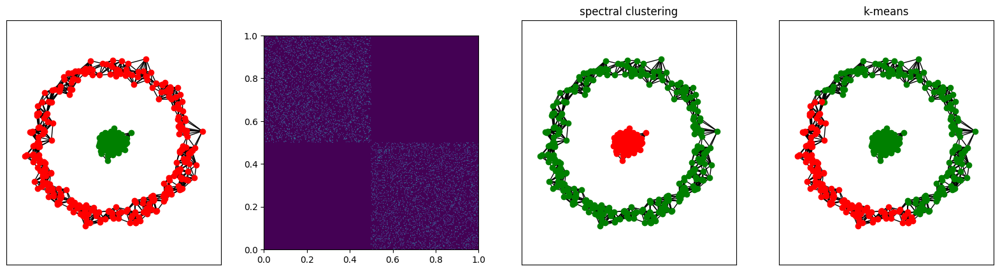

point_and_circle - KNN OR graph - k = 50


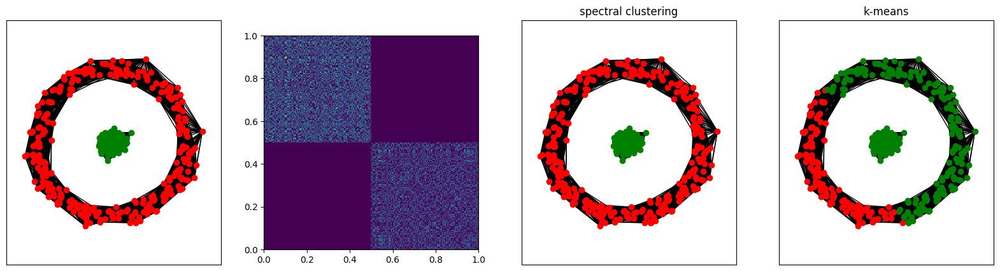

point_and_circle - KNN OR graph - k = 100


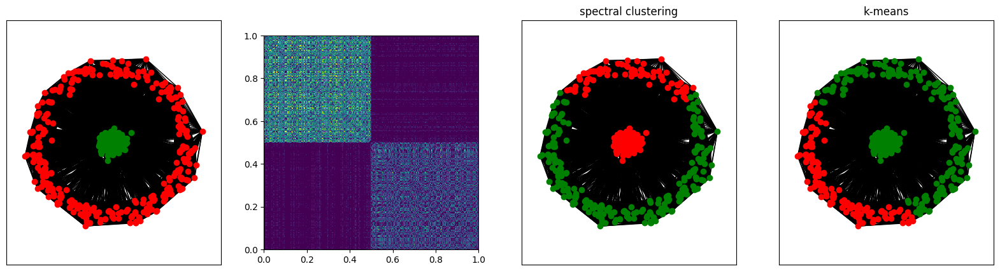

point_and_circle - KNN AND graph - k = 10


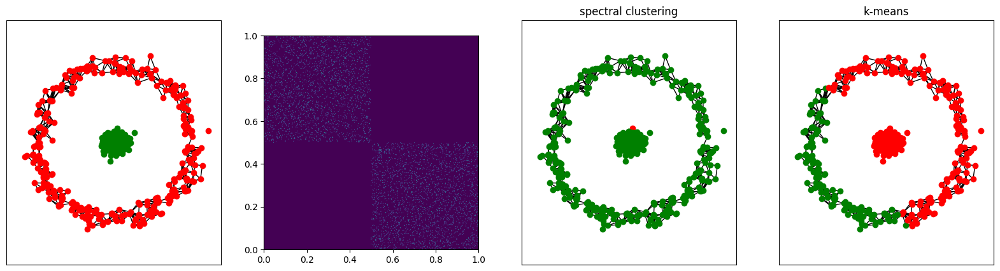

point_and_circle - KNN AND graph - k = 50


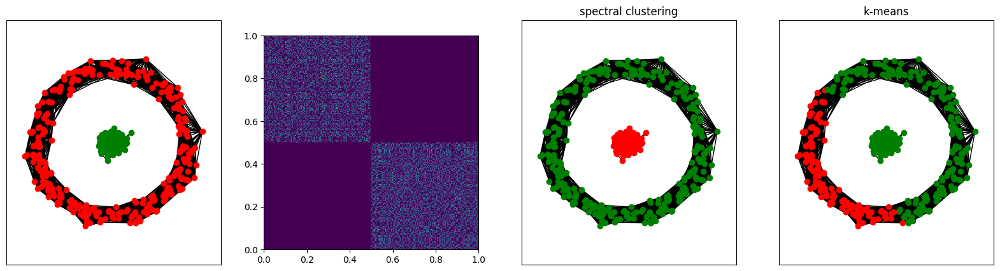

point_and_circle - KNN AND graph - k = 100


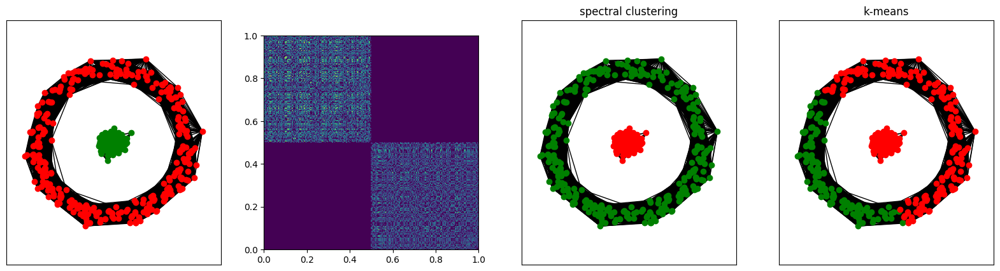

blobs - Epsilon graph - eps = 0.1


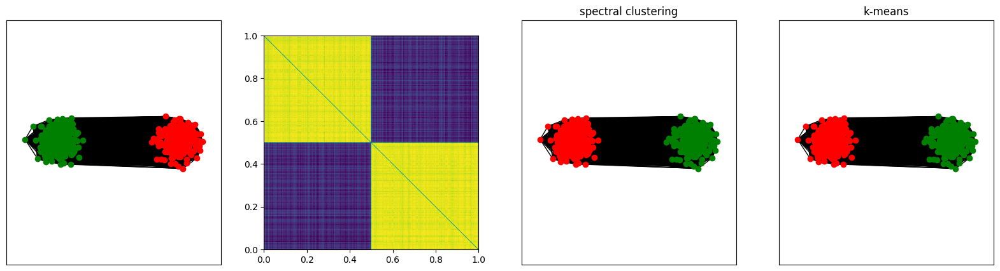

blobs - Epsilon graph - eps = 0.5


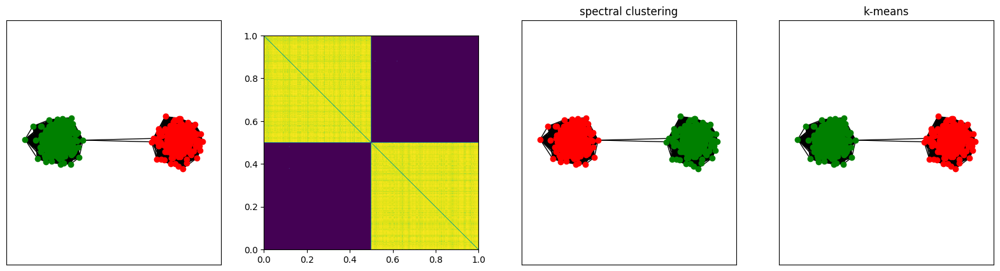

blobs - Epsilon graph - eps = 0.9


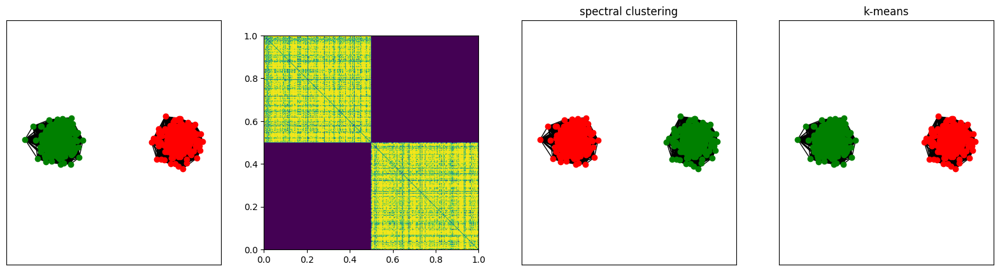

blobs - KNN OR graph - k = 10


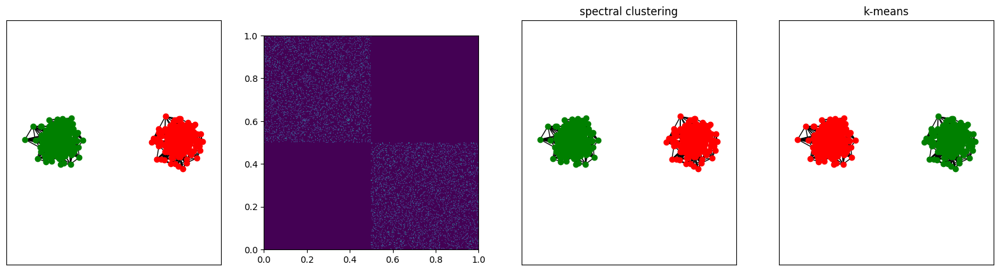

blobs - KNN OR graph - k = 50


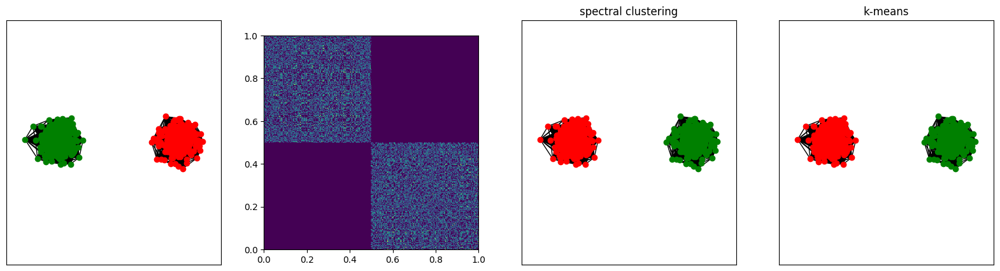

blobs - KNN OR graph - k = 100


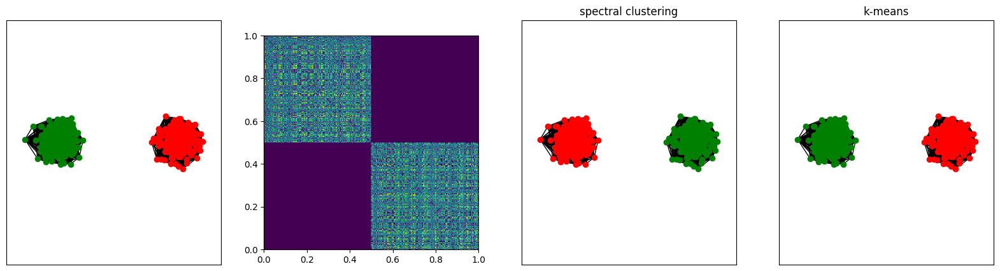

blobs - KNN AND graph - k = 10


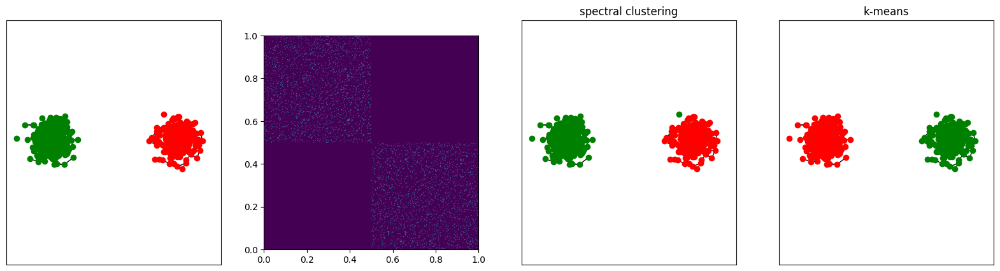

blobs - KNN AND graph - k = 50


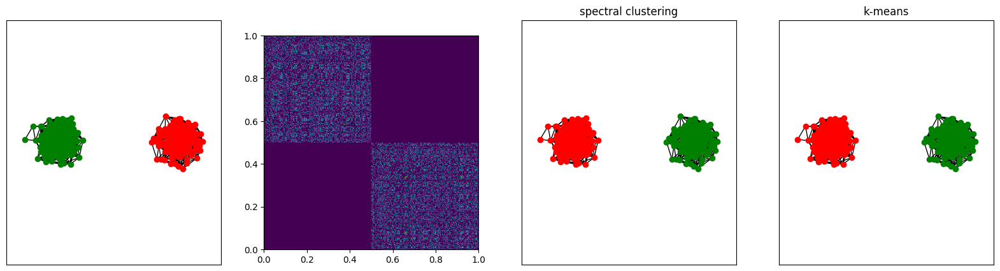

blobs - KNN AND graph - k = 100


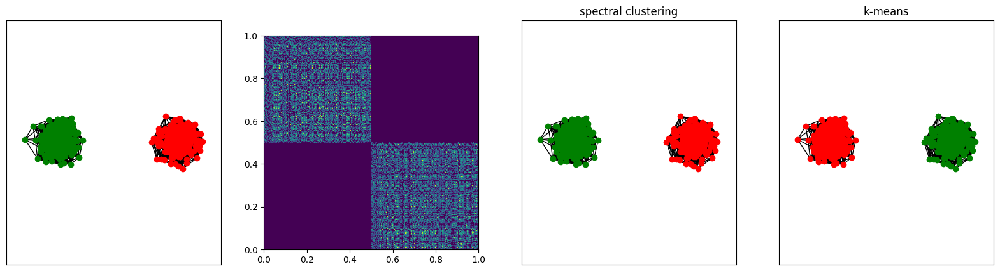

In [20]:
for fn in [two_moons, worst_case_blob, point_and_circle, blobs]:

    X, Y = fn(num_samples=600)
    num_classes = len(np.unique(Y))
    #plot_clusters(X, Y, fignum=str(fn), show=False)
    #plt.title(str(fn.__name__))
    #plt.show()

    for eps in [0.1, 0.5, 0.9]:
        print(f"{str(fn.__name__)} - Epsilon graph - eps = {eps}")
        W = build_similarity_graph(X, var=1, eps=eps)
        clustering_and_plot(X, Y, W, num_classes=num_classes)

    for k in [10, 50, 100]:
        print(f"{str(fn.__name__)} - KNN OR graph - k = {k}")
        W = build_similarity_graph(X, var=1, k=k, knn_or=True)
        clustering_and_plot(X, Y, W, num_classes=num_classes)

    for k in [10, 50, 100]:
        print(f"{str(fn.__name__)} - KNN AND graph - k = {k}")
        W = build_similarity_graph(X, var=1, k=k, knn_or=False)
        clustering_and_plot(X, Y, W, num_classes=num_classes)


### Q2.1: Build a graph starting from the data generated in `blobs`, and keep the graph connected. Use `spectral_clustering` to cluster the data. Motivate your choice on which eigenvectors to use and how you computed the clustering assignments from the eigenvectors. Now compute a similar clustering using the built-in k-means and compare the results.

> The K-Means algorithm works very well on the blobs dataset. In fact, as the clusters are disjoint and far apart, the clustering algorithm is fully adapted to this type of dataset. However, for spectral clustering, we can see that it is very important to choose the eigenvector indices to obtain correct clustering. The second eigenvector of the Laplacian gives correct clustering when selected. From the results, we can deduce that the following three eigenvectors do not give correct clustering.

In [21]:
def plot_eigvectors(L, chosen_eig_indices):
    eig_values, eig_vectors = scipy.linalg.eig(L)
    argsort = np.argsort(eig_values)
    E = np.diag(eig_values[argsort].real)
    U = eig_vectors[:, argsort].real
    n = len(chosen_eig_indices)
    plt.figure(figsize=(20, 5 + 5 * (n//3)))
    for i, idx in enumerate(chosen_eig_indices):
        plt.subplot(1 + (n//3), 3, i + 1)
        plt.plot(U[:, chosen_eig_indices[idx]])
        plt.title(f"Eigenvector {idx}")
    plt.show()

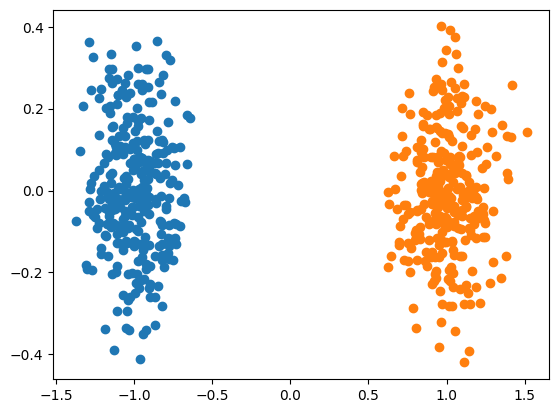

In [22]:
X, Y = blobs(num_samples=600)
plot_clusters(X, Y)

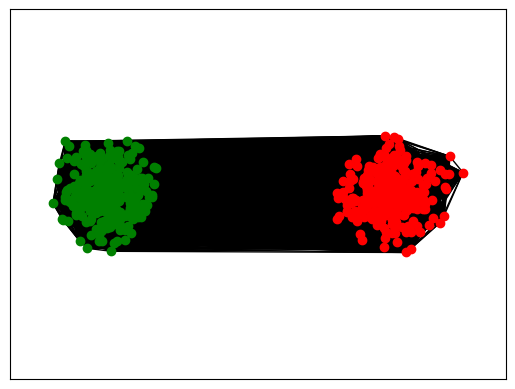

In [23]:
W = build_similarity_graph(X, var=1, eps=0)
plot_edges_and_points(X, Y, W)

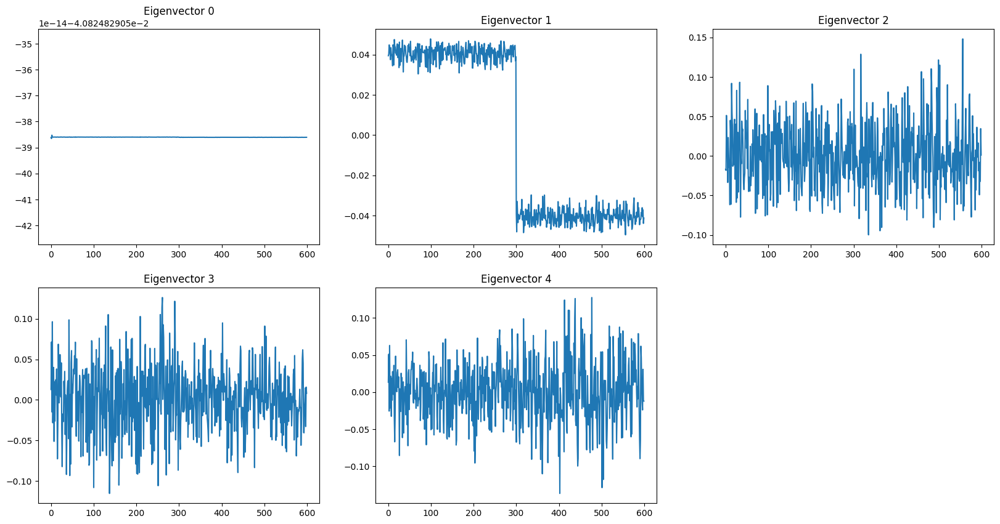

In [24]:
L = build_laplacian(W, laplacian_normalization='rw')
plot_eigvectors(L, [0, 1, 2, 3, 4])

Chosen eig indices: [1]


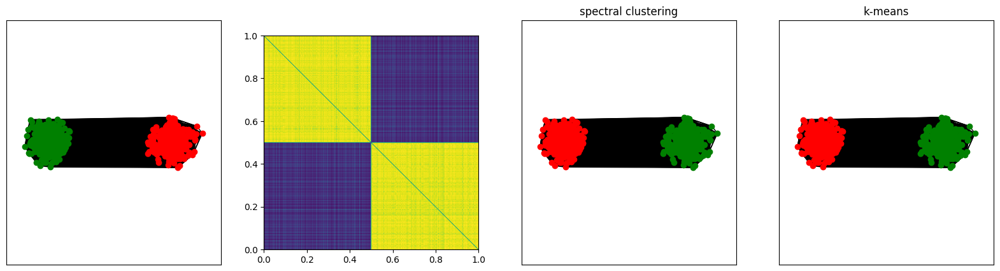

Chosen eig indices: [2]


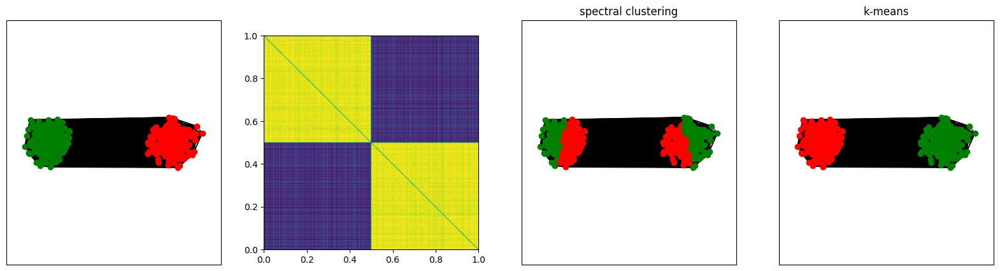

Chosen eig indices: [3]


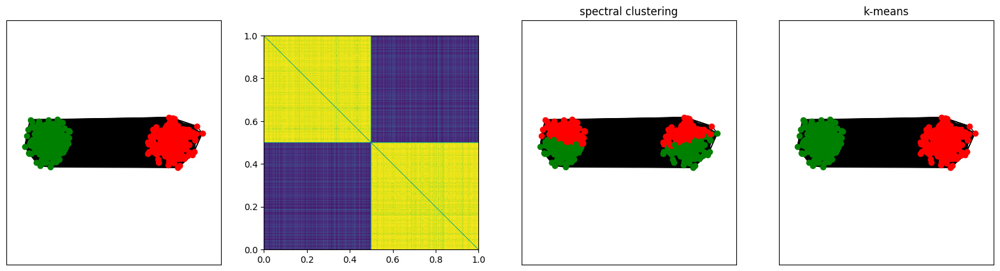

Chosen eig indices: [4]


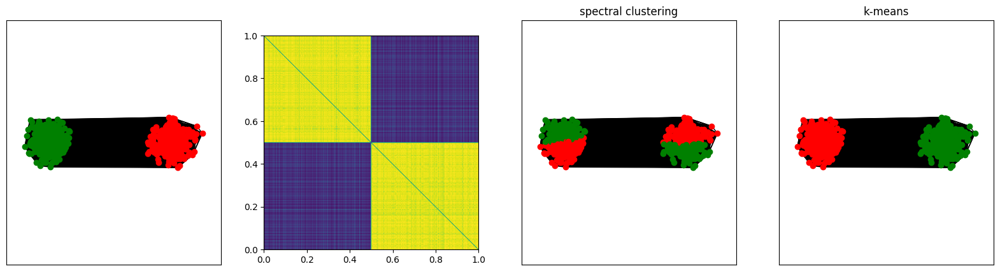

Chosen eig indices: [1, 2]


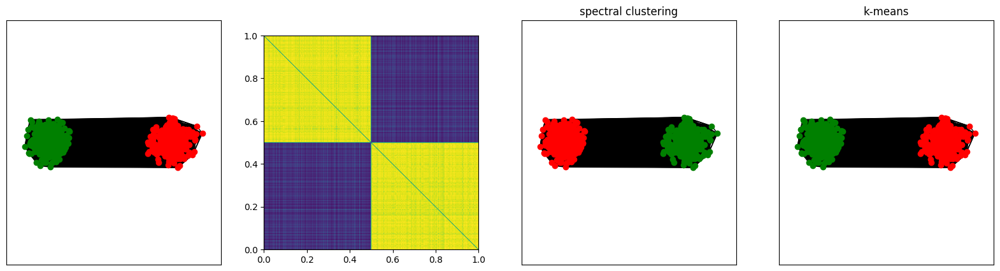

Chosen eig indices: [1, 3]


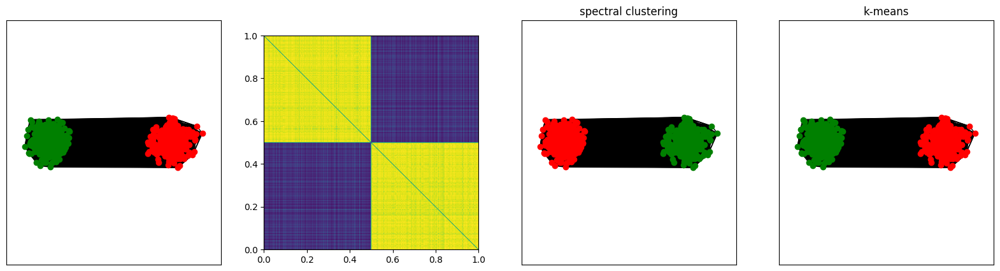

Chosen eig indices: [1, 4]


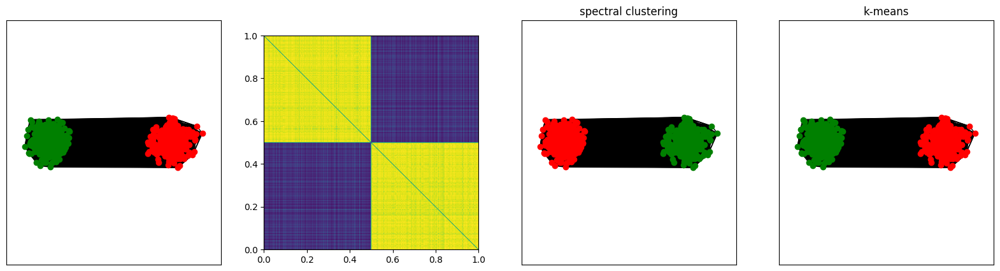

Chosen eig indices: [2, 3]


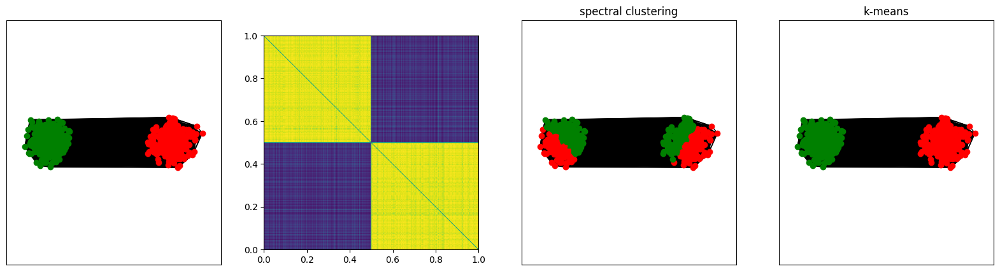

Chosen eig indices: [2, 4]


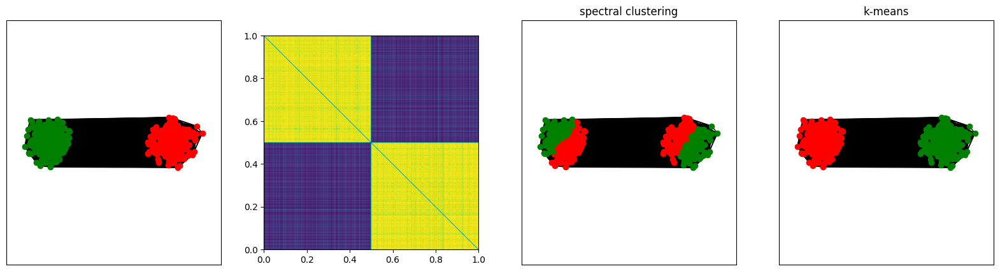

Chosen eig indices: [3, 4]


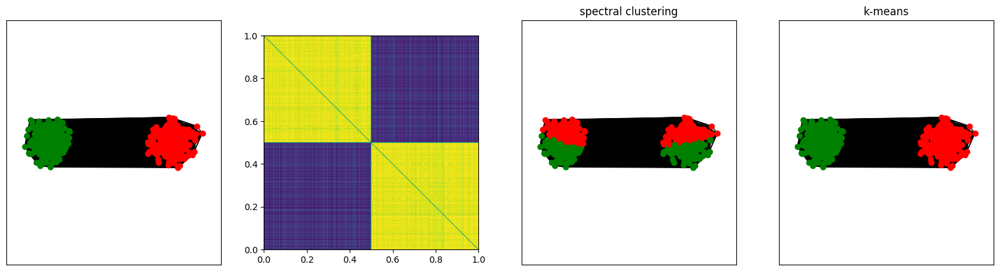

Chosen eig indices: [1, 2, 3]


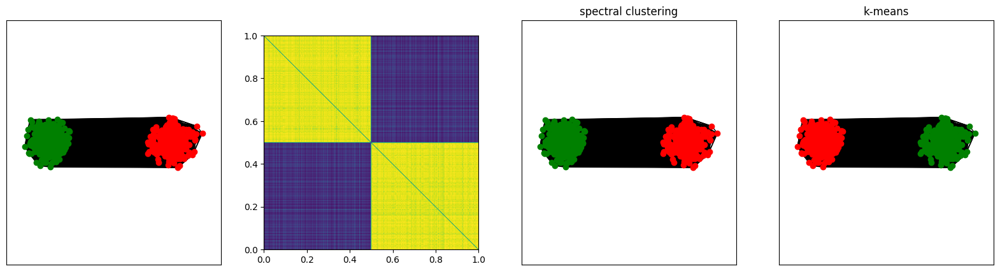

Chosen eig indices: [1, 2, 4]


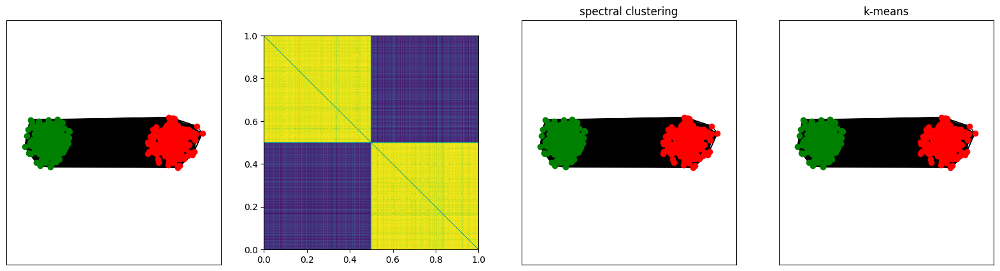

Chosen eig indices: [1, 3, 4]


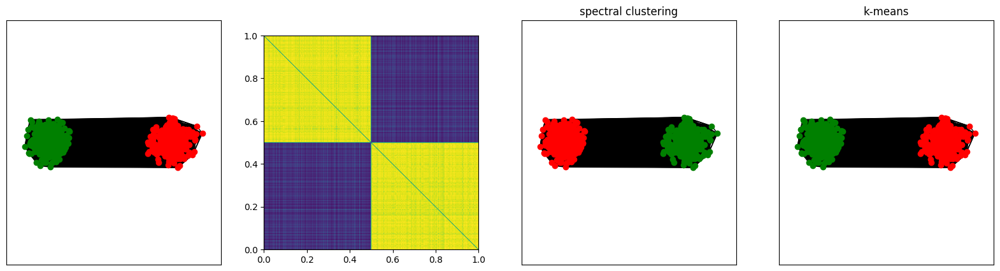

Chosen eig indices: [2, 3, 4]


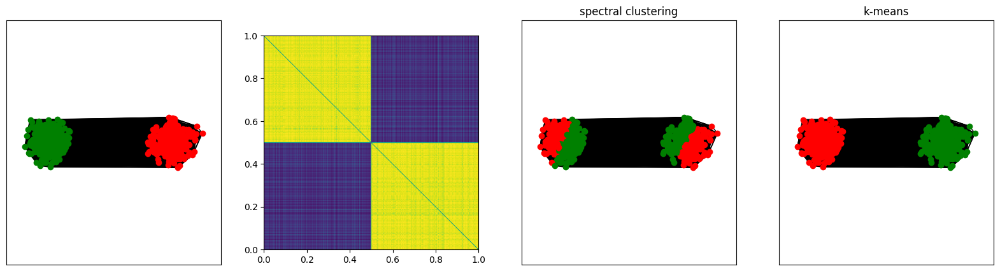

In [25]:
all_spectral_score = []
all_kmeans_score = []
all_chosen_eig_indices = [[1], [2], [3], [4], [1, 2], [1, 3], [1, 4], [2, 3], [2, 4], [3, 4], 
                          [1, 2, 3], [1, 2, 4], [1, 3, 4], [2, 3, 4]]

for chosen_eig_indices in all_chosen_eig_indices:
    print(f"Chosen eig indices: {chosen_eig_indices}")
    spectral_score, kmeans_score = clustering_and_plot(
        X, Y, W, 
        laplacian_normalization='rw', 
        num_classes=2, 
        verbose=True,
        chosen_eig_indices=chosen_eig_indices
        )
    all_spectral_score.append(spectral_score)
    all_kmeans_score.append(kmeans_score)

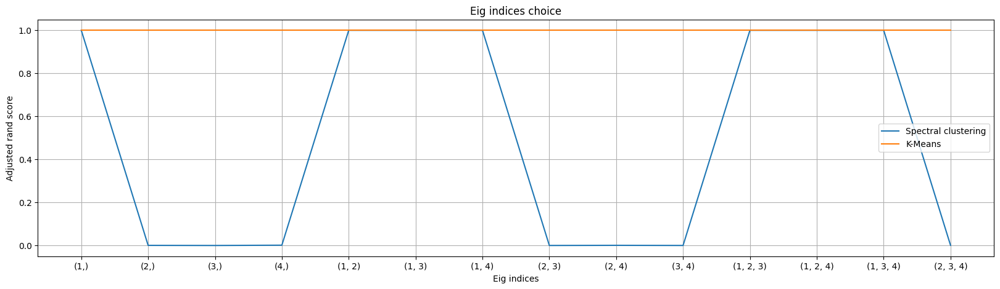

In [26]:
plt.figure(figsize=(20, 5))
plt.plot(np.arange(len(all_chosen_eig_indices)), all_spectral_score, label="Spectral clustering")
plt.plot(np.arange(len(all_chosen_eig_indices)), all_kmeans_score, label="K-Means")
plt.title(f"Eig indices choice")
plt.xticks(np.arange(len(all_chosen_eig_indices)), list(map(lambda x:str(tuple(x)), all_chosen_eig_indices)), rotation=0)
plt.grid(True)
plt.xlabel("Eig indices")
plt.ylabel("Adjusted rand score")
plt.legend()
plt.show()


### Q2.2: Build a graph starting from the data generated in `blobs`, but this time make it so that the two components are separated. How do you choose which eigenvectors to use in this case? Motivate your answer.

> As in the previous question, the K-Means algorithm provides correct clustering. It's important to look at the eigenvectors of the Laplacian, which enable correct clustering to be obtained with spectral clustering. Note that the first Laplacian eigenvector or the second Laplacian eigenvector easily distinguish the two clusters. However, combining these eigenvectors with other Laplacian eigenvectors, such as the following three, may not result in correct clustering.

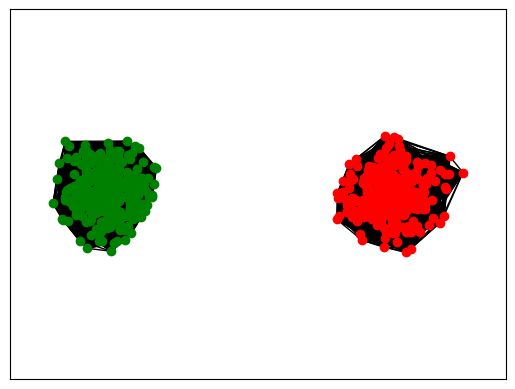

In [27]:
W = build_similarity_graph(X, var=1, k=299)
plot_edges_and_points(X, Y, W)

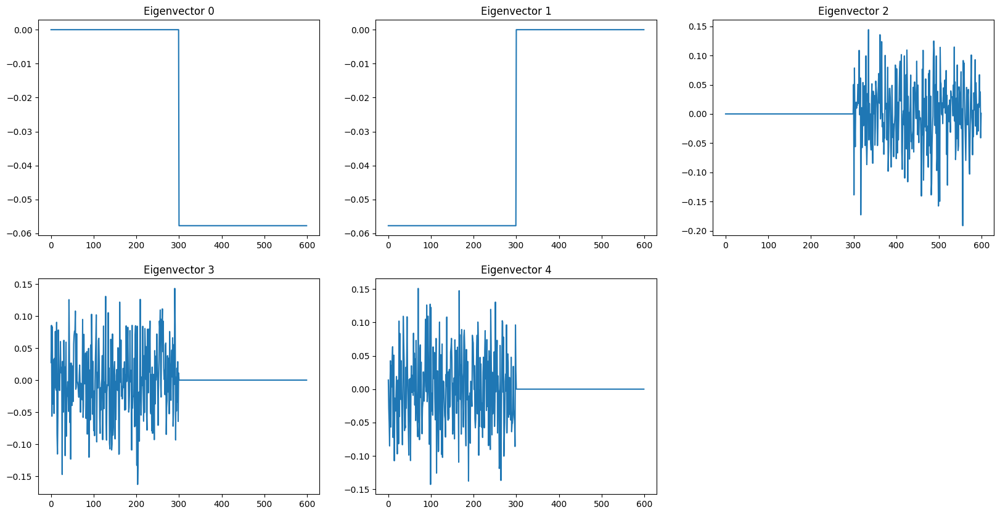

In [28]:
L = build_laplacian(W, laplacian_normalization='rw')
plot_eigvectors(L, [0, 1, 2, 3, 4])

Chosen eig indices: [0]


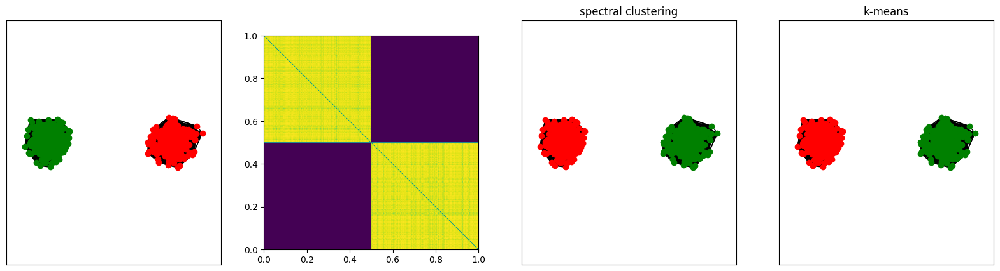

Chosen eig indices: [1]


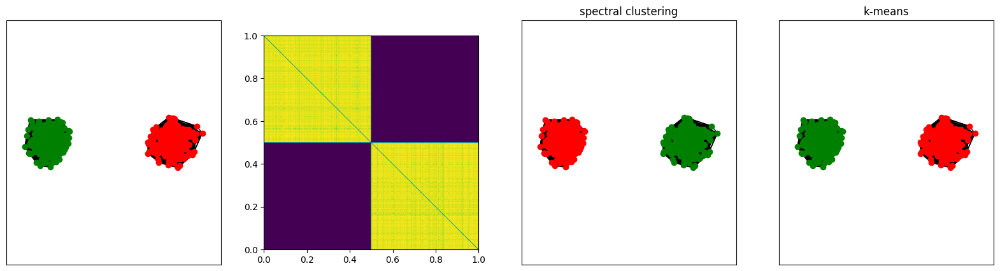

Chosen eig indices: [2]


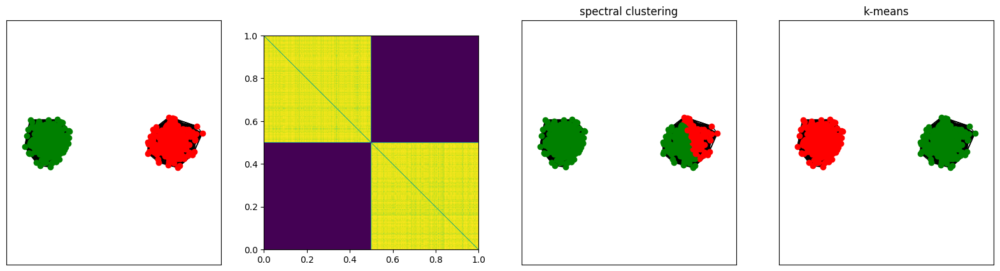

Chosen eig indices: [3]


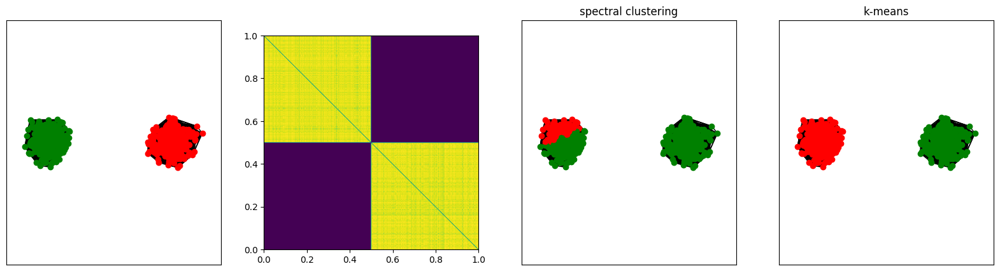

Chosen eig indices: [4]


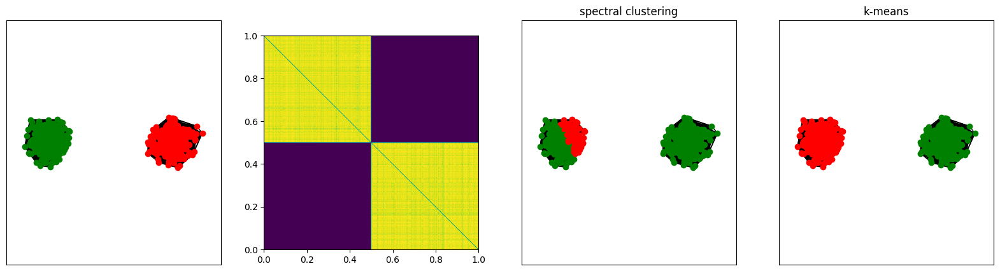

Chosen eig indices: [0, 1]


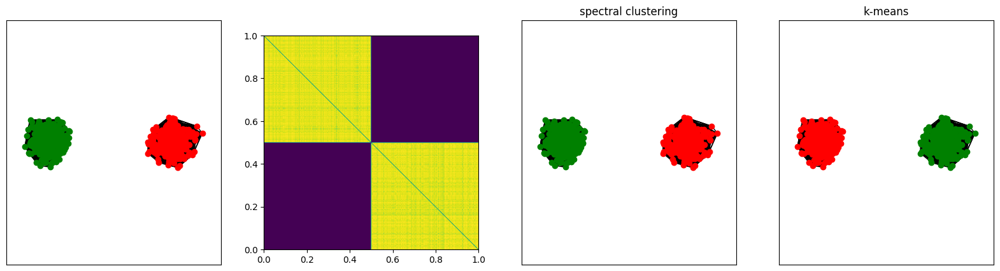

Chosen eig indices: [0, 2]


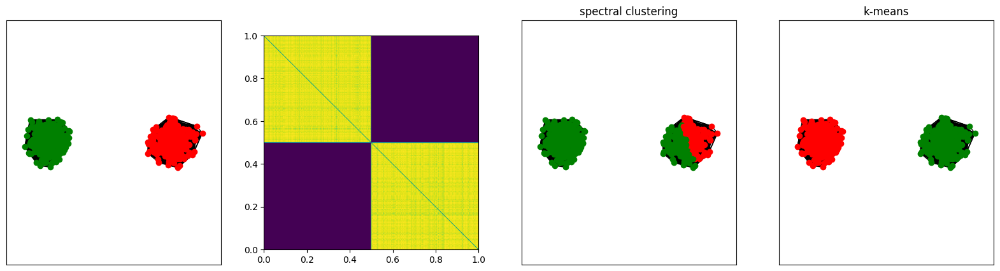

Chosen eig indices: [0, 3]


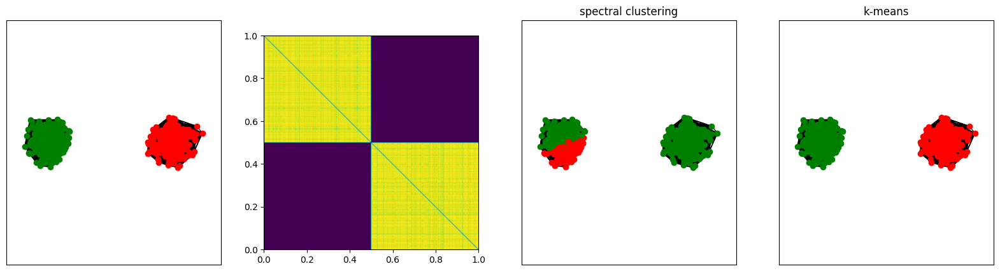

Chosen eig indices: [0, 4]


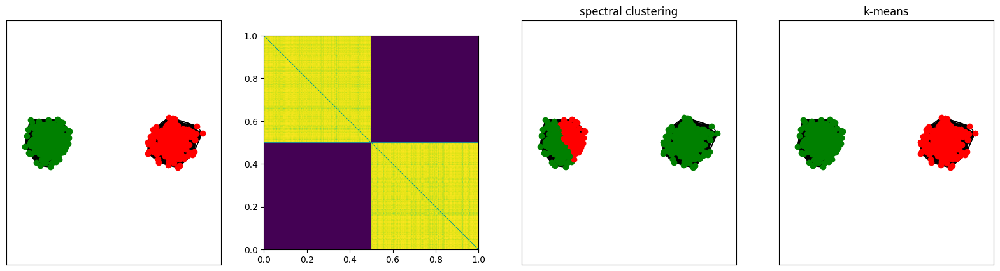

Chosen eig indices: [1, 2]


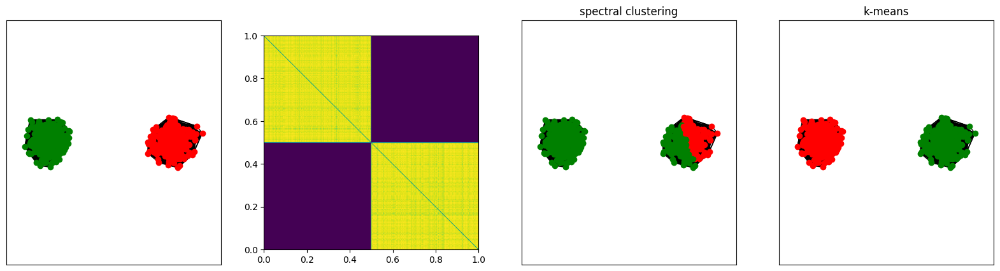

Chosen eig indices: [1, 3]


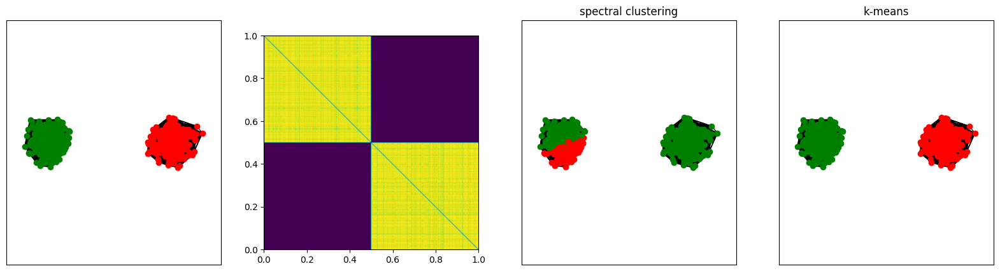

Chosen eig indices: [1, 4]


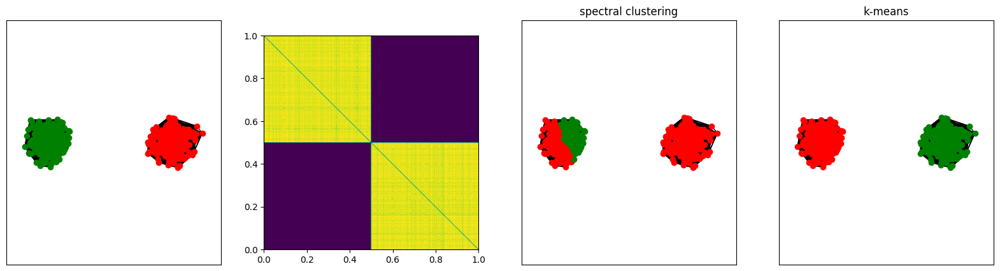

Chosen eig indices: [2, 3]


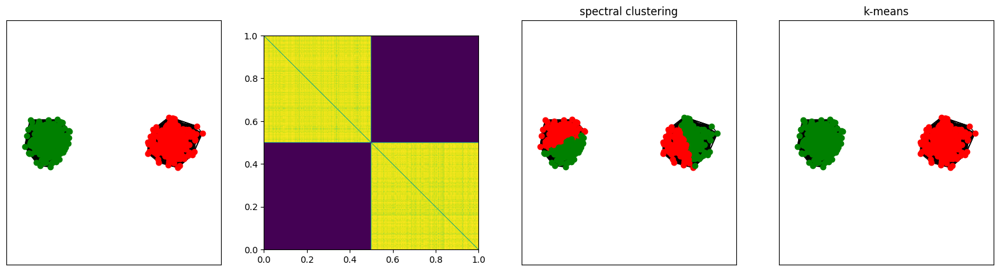

Chosen eig indices: [2, 4]


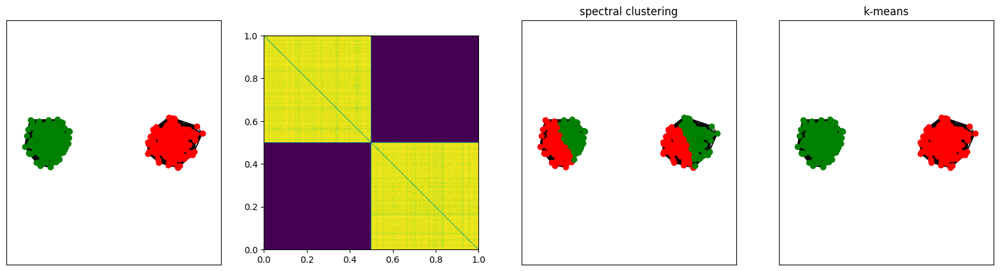

Chosen eig indices: [3, 4]


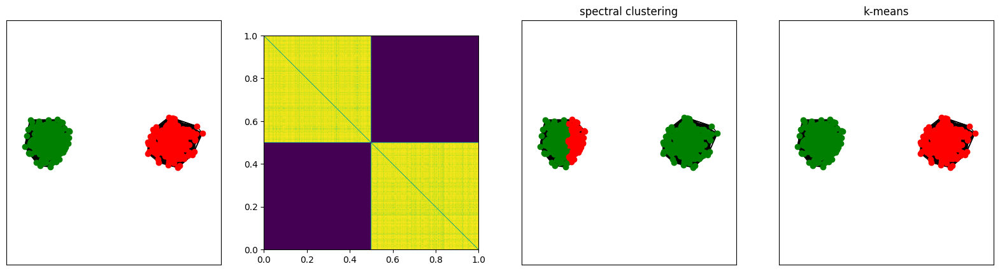

Chosen eig indices: [1, 2, 3]


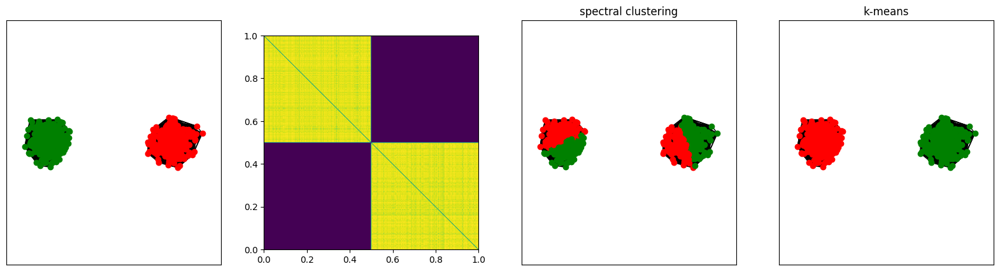

Chosen eig indices: [1, 2, 4]


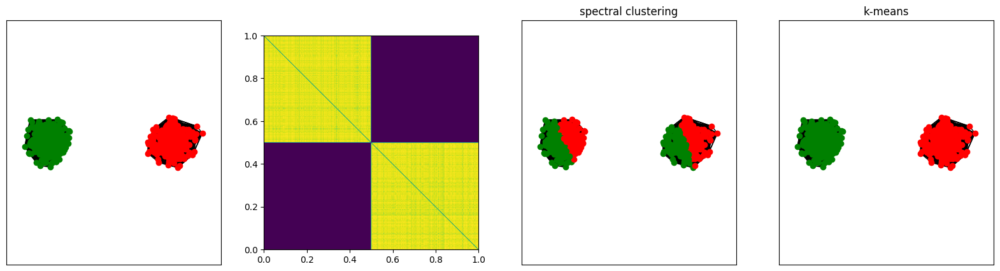

Chosen eig indices: [1, 3, 4]


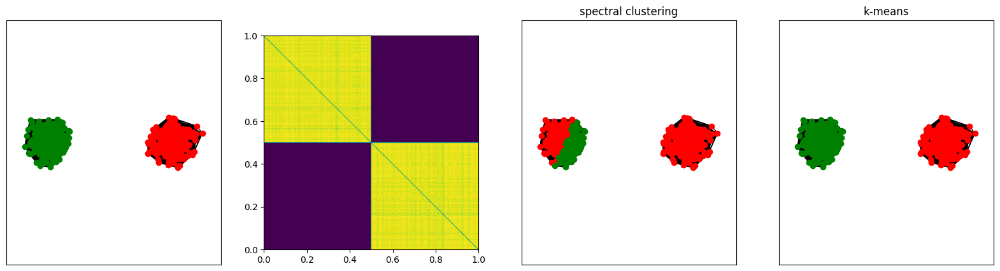

Chosen eig indices: [2, 3, 4]


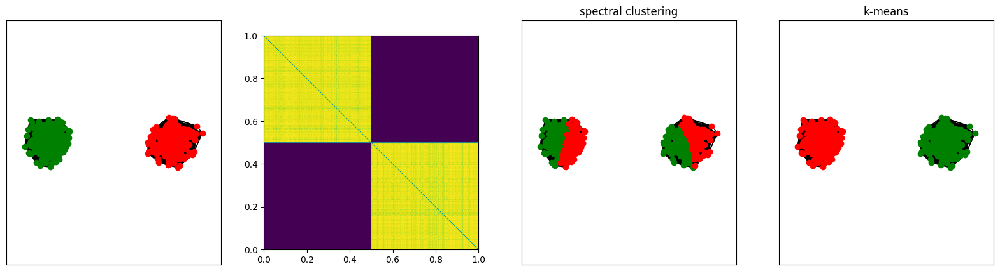

In [29]:
all_spectral_score = []
all_kmeans_score = []
all_chosen_eig_indices = [[0], [1], [2], [3], [4], [0, 1], [0, 2], [0, 3], [0, 4], [1, 2], [1, 3], [1, 4], [2, 3], [2, 4], [3, 4], 
                          [1, 2, 3], [1, 2, 4], [1, 3, 4], [2, 3, 4]]

for chosen_eig_indices in all_chosen_eig_indices:
    print(f"Chosen eig indices: {chosen_eig_indices}")
    spectral_score, kmeans_score = clustering_and_plot(
        X, Y, W, 
        laplacian_normalization='rw', 
        num_classes=2, 
        verbose=True,
        chosen_eig_indices=chosen_eig_indices
        )
    all_spectral_score.append(spectral_score)
    all_kmeans_score.append(kmeans_score)

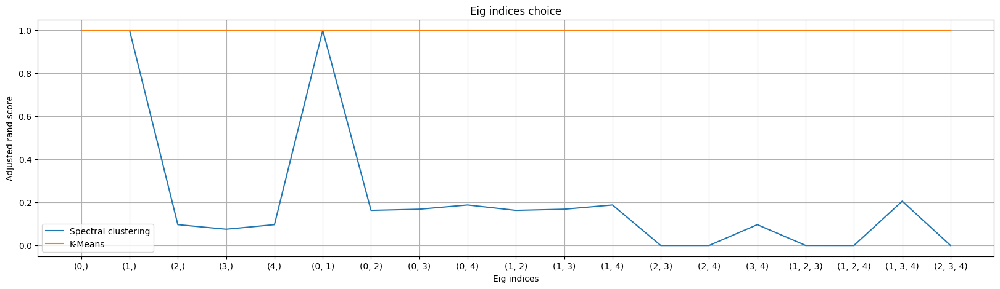

In [30]:
plt.figure(figsize=(20, 5))
plt.plot(np.arange(len(all_chosen_eig_indices)), all_spectral_score, label="Spectral clustering")
plt.plot(np.arange(len(all_chosen_eig_indices)), all_kmeans_score, label="K-Means")
plt.title(f"Eig indices choice")
plt.xticks(np.arange(len(all_chosen_eig_indices)), list(map(lambda x:str(tuple(x)), all_chosen_eig_indices)), rotation=0)
plt.grid(True)
plt.xlabel("Eig indices")
plt.ylabel("Adjusted rand score")
plt.legend()
plt.show()

### Q2.3: In the function spectral_clustering, implement an automatic strategy to choose the eigenvectors to use for clustering, when chosen_eig_indices=None. Explain your strategy. Generate a dataset with 4 blobs and test your function. What happens when the variance of the blobs increase?

> We proceeded as follows to automatically select the Laplacian eigenvector indices for spectral clustering. We removed the first eigenvector, which very often associates all points with the same class. We then concentrated on eigenvectors with very small eigenvalues. The number chosen will be limited to eigenvectors whose sum of normalized eigenvalues is less than a threshold value.
Several experiments have been carried out, enabling us to set this threshold at $10^{-5}$. Finally, the selected eigenvectors are used for clustering with K-Means at the end of spectral clustering.

> As variance increases, points from different clusters become increasingly mixed, making the task of clustering more complex. The adjusted rand score of clustering with K-Means decreases with variance. For spectral clustering, the choice of Laplacian eigenvectors also becomes more complex.   Our automatic choice method therefore performs less well. However, for very small variances, we can easily see which eigenvectors to choose for correct clustering.

Blob var = 0.10


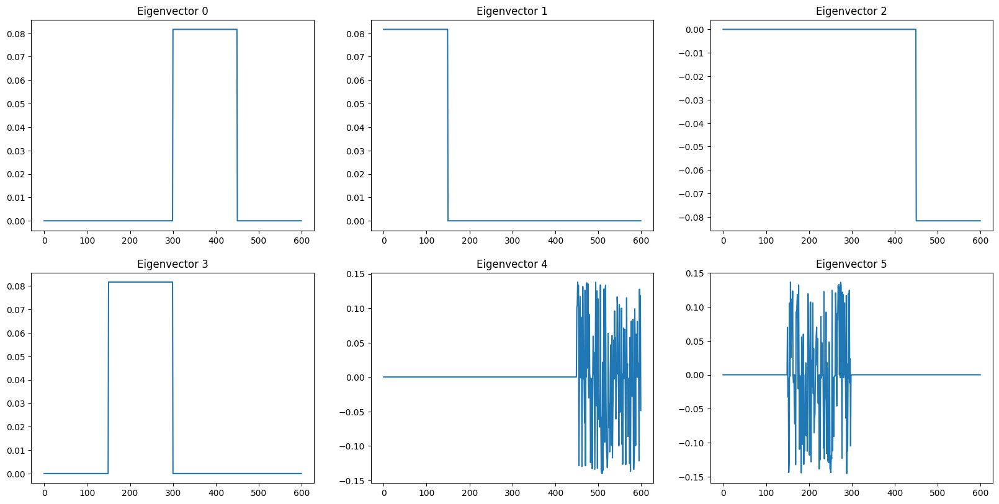

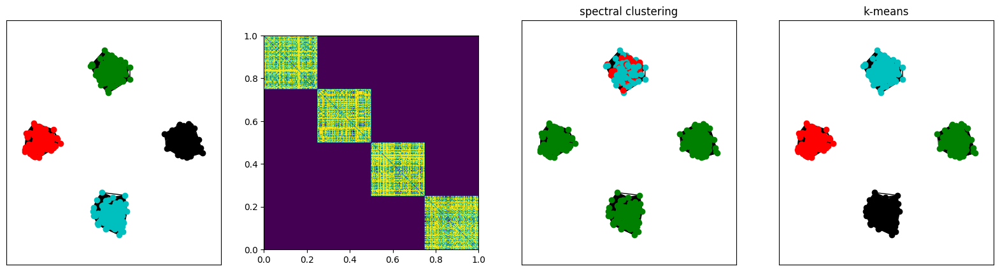

Blob var = 0.20


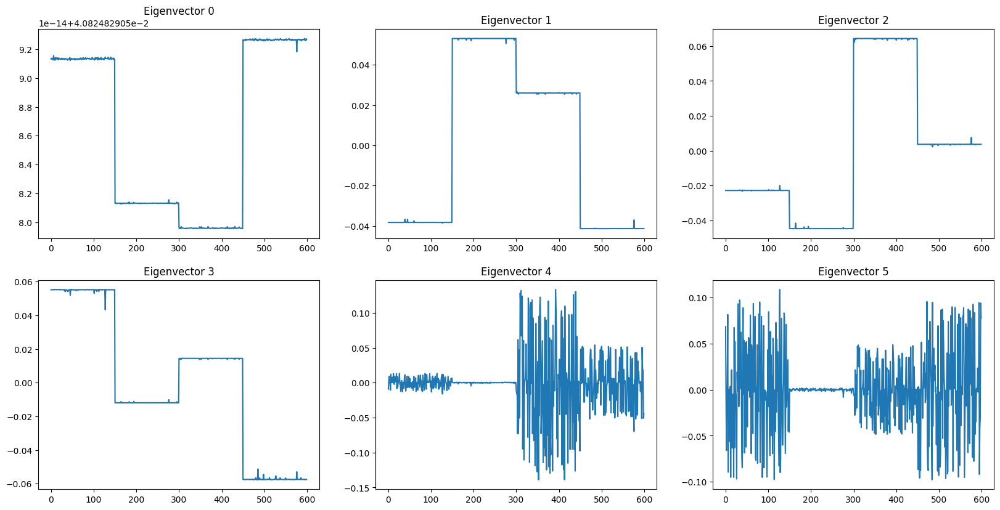

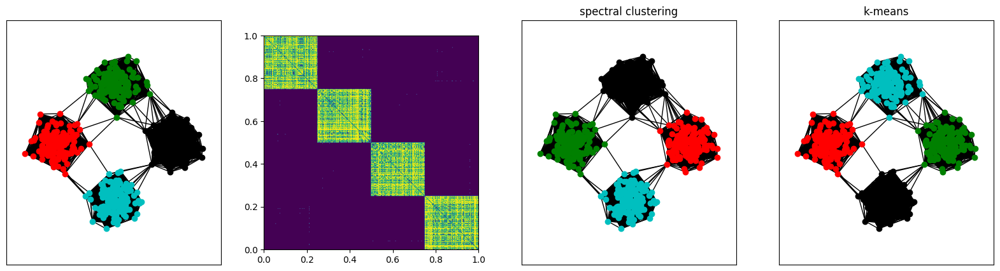

Blob var = 0.30


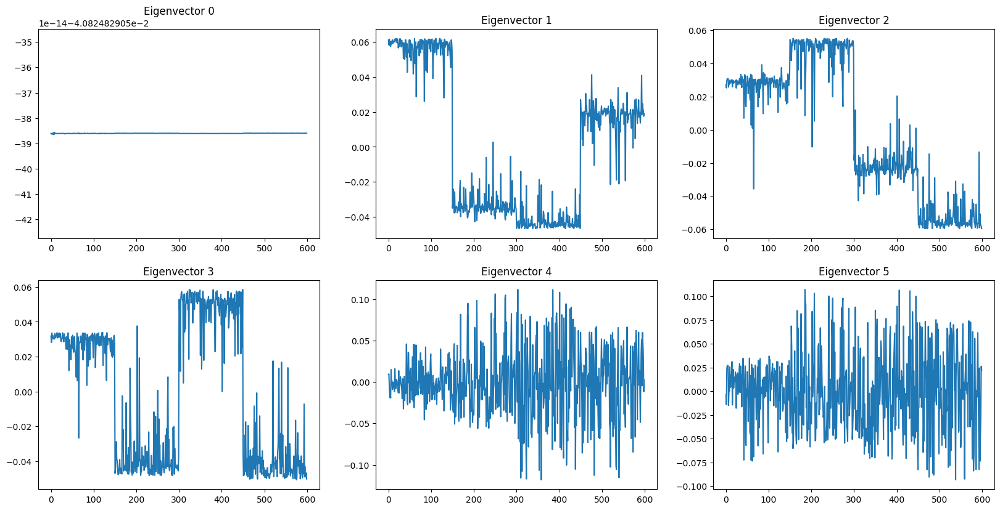

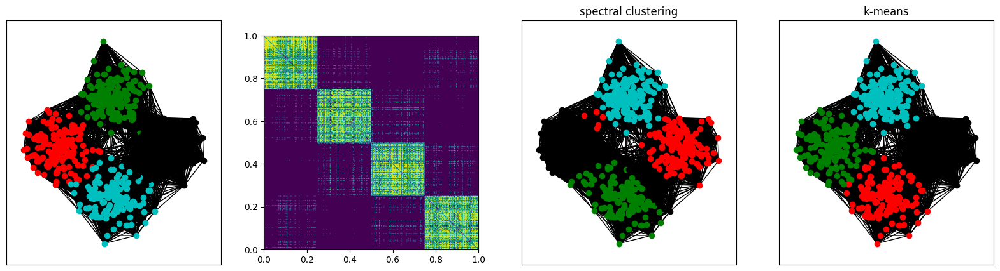

Blob var = 0.40


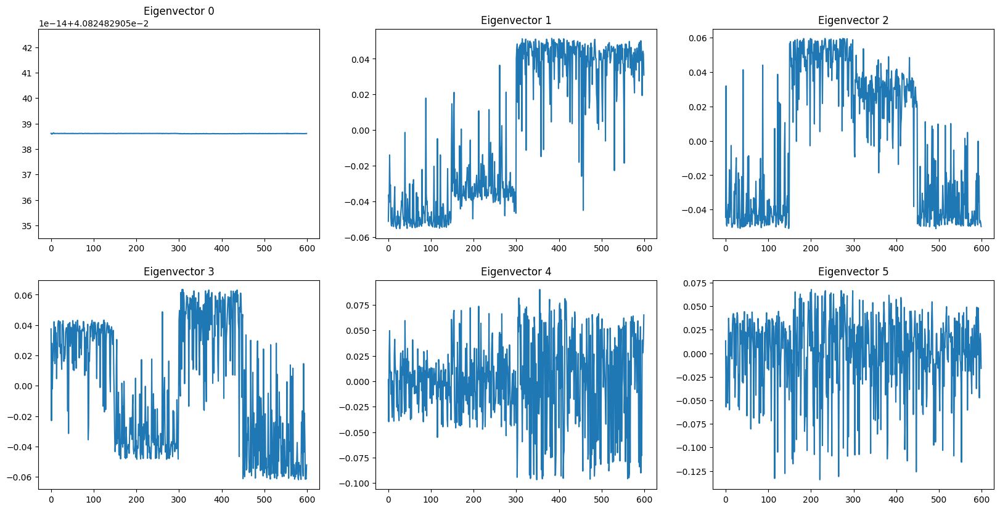

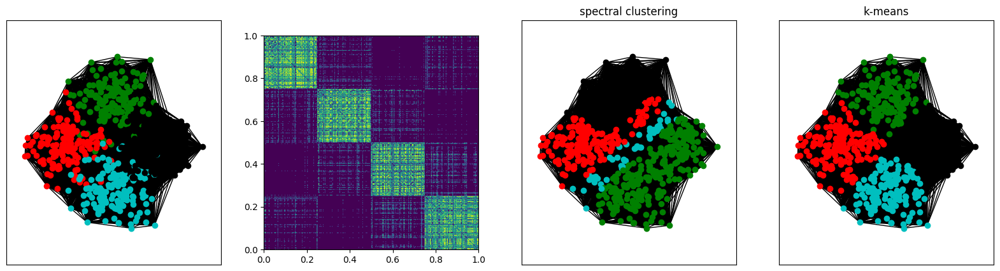

Blob var = 0.50


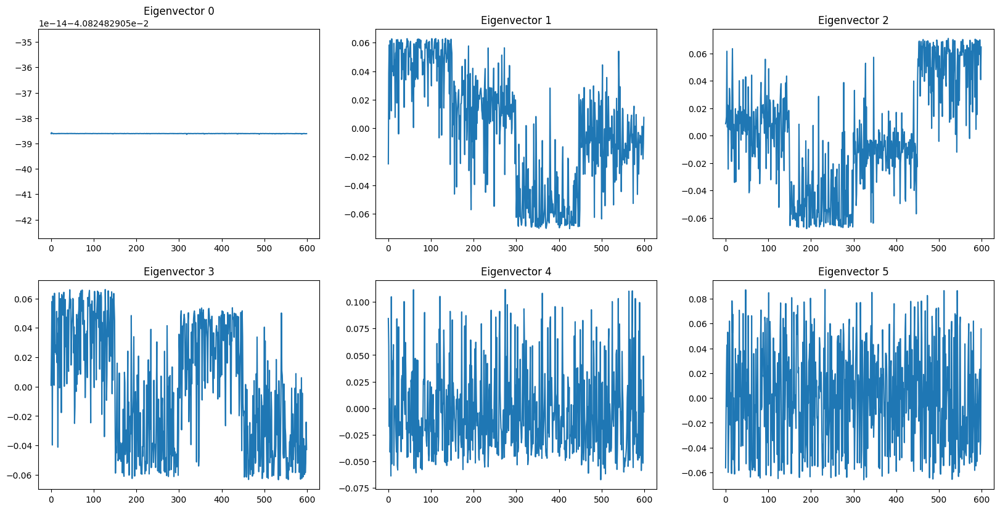

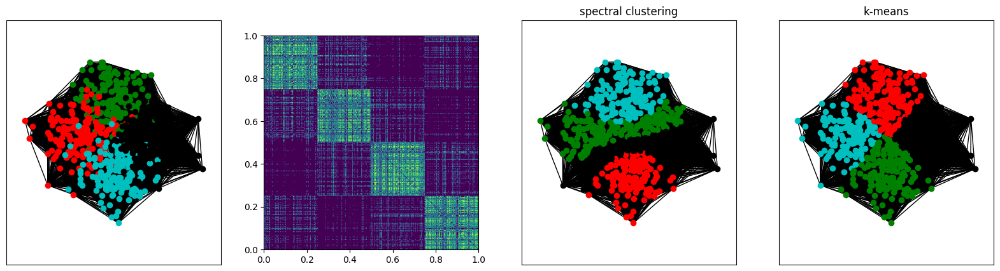

In [31]:
blob_vars = [0.1, 0.2, 0.3, 0.4, 0.5]
all_spectral_score = []
all_kmeans_score = []

for blob_var in blob_vars:
    X, Y = blobs(num_samples=600, n_blobs=4, blob_var=blob_var)
    W = build_similarity_graph(X, var=1, k=100)
    L = build_laplacian(W, laplacian_normalization='rw')
    print(f"Blob var = {blob_var:.2f}")
    plot_eigvectors(L, chosen_eig_indices=[0, 1, 2, 3, 4, 5])
    spectral_score, kmeans_score = clustering_and_plot(
        X, Y, W, 
        laplacian_normalization='rw', 
        num_classes=4, 
        verbose=True,
        chosen_eig_indices=None
    )
    all_spectral_score.append(spectral_score)
    all_kmeans_score.append(kmeans_score)
    

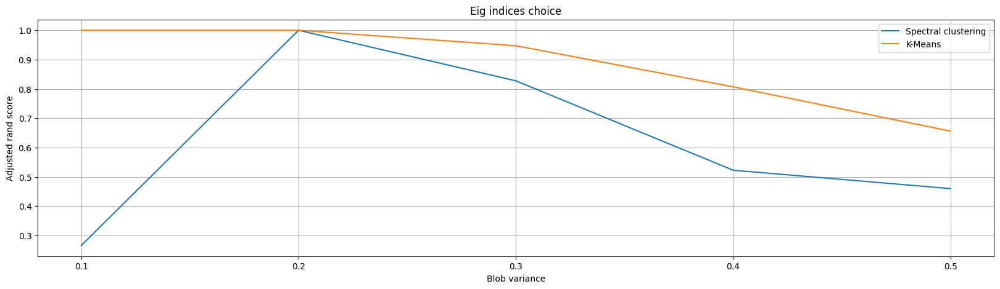

In [32]:
plt.figure(figsize=(20, 5))
plt.plot(np.arange(len(blob_vars)), all_spectral_score, label="Spectral clustering")
plt.plot(np.arange(len(blob_vars)), all_kmeans_score, label="K-Means")
plt.title(f"Eig indices choice")
plt.xticks(np.arange(len(blob_vars)), blob_vars)
plt.grid(True)
plt.xlabel("Blob variance")
plt.ylabel("Adjusted rand score")
plt.legend()
plt.show()

### Q2.4: When you built the cluster assignment, did you use thresholding, k-means or both? Do you have any opinion on when to use each?

> When assigning clusters, we chose the K-means method. 

> The K-means method, in which clustering is done automatically, is better because by choosing the wrong threshold value for the threshold method, we can get the wrong clustering.  The K-means method is more general and can also be used for multidimensional clustering vectors.

> Thresholding is easy to use for simple cases of datasets when we have information about the clustering vector.

### Q2.5: Generate `two_moons` data and compare spectral clustering to k-means. Do you notice any difference? Taking into consideration the graph structure, can you explain them?

> It can be seen that the K-Means algorithm fails to distinguish between the different clusters in such a configuration. The adjusted rand score of K-Means on the dataset is zero. For spectral clustering, it is necessary to find the right parameters for correct clustering, so that the adjusted rand score is 1.

> We then compared K-Means and spectral clustering with both a K-NN graph and a $\epsilon$ graph. Certain values of k for the K-NN graph, just like certain values of $\epsilon$ that are too large or too small, fail to produce correct clustering in the case of spectral clustering. However, unlike K-Means, which fails completely in this task, several values of k for the K-NN graph and several values of $\epsilon$ for the $\epsilon$ graph succeed in inducing correct clustering.

> In the case of $\epsilon$ graphs, we note that the graph structure for which we are able to recover correct clustering with spectral clustering is a graph for which we only connect nodes with a very high similarity to each other (here 0.75 for example). However, keeping only edges with a similarity higher than 0.95 means that we lose information on the connectivity within clusters, which tends to produce a clustering that is not correct, as in the case of keeping edges with very low similarities.

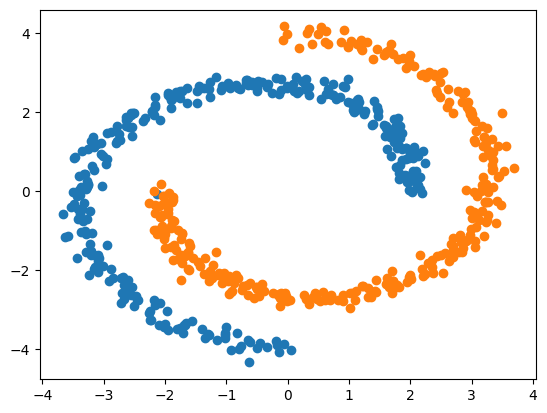

In [33]:
X, Y = two_moons(num_samples=600)
plot_clusters(X, Y)

two_moons - KNN OR graph - k = 10


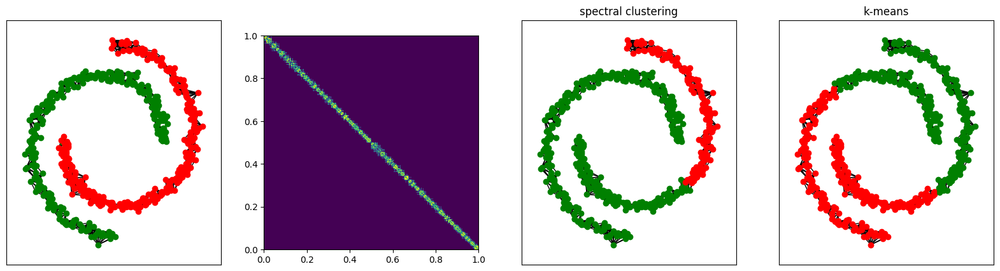

two_moons - KNN OR graph - k = 11


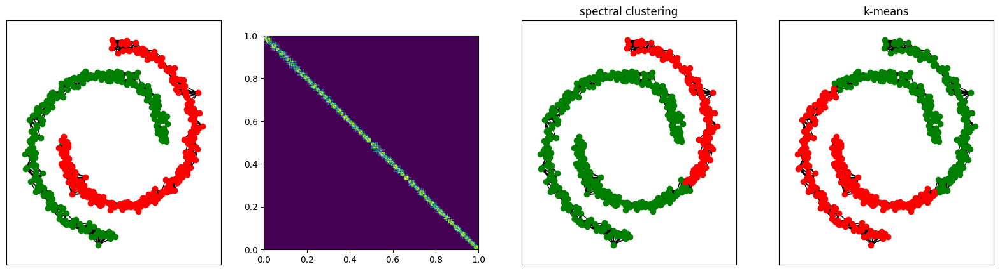

two_moons - KNN OR graph - k = 12


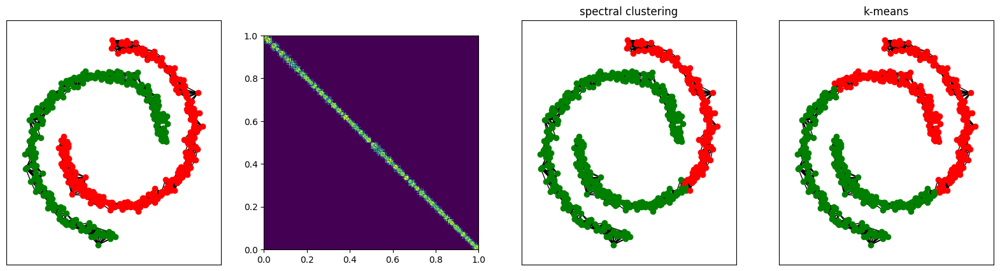

two_moons - KNN OR graph - k = 13


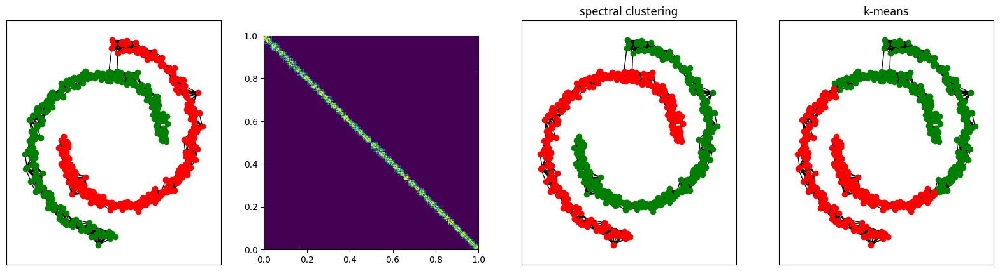

two_moons - KNN OR graph - k = 14


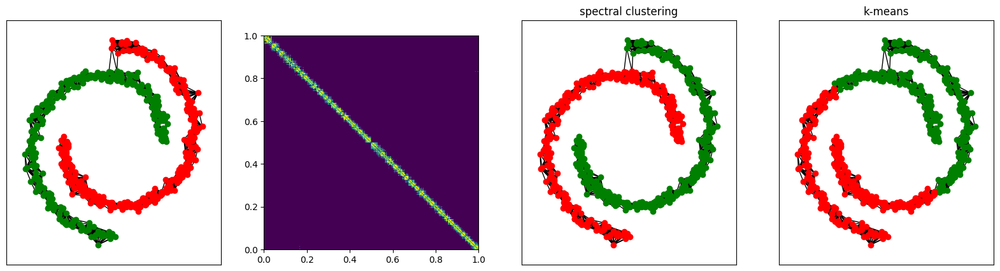

two_moons - KNN OR graph - k = 15


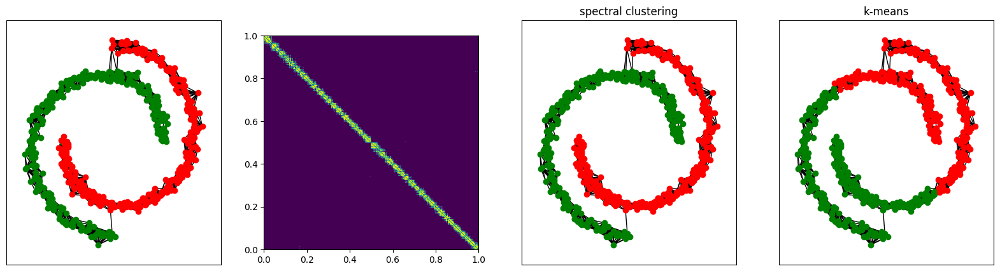

two_moons - KNN OR graph - k = 16


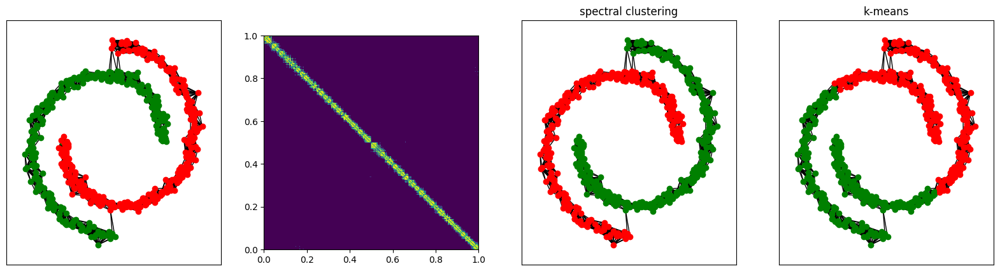

two_moons - KNN OR graph - k = 17


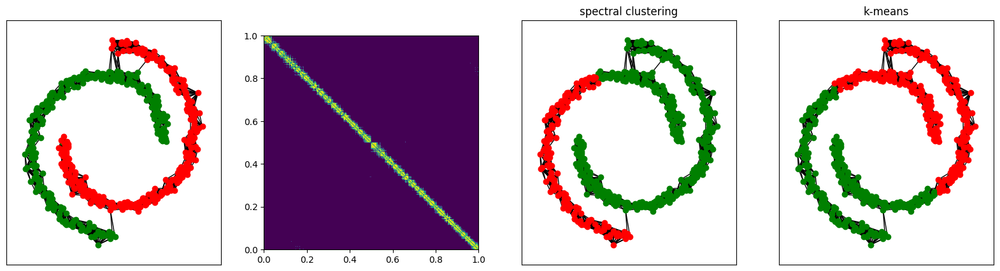

two_moons - KNN OR graph - k = 18


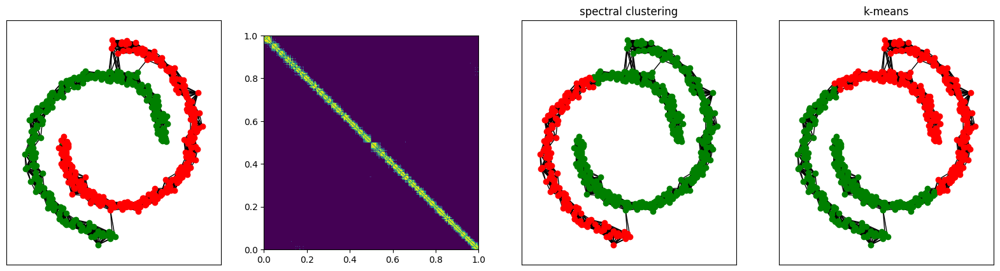

two_moons - KNN OR graph - k = 19


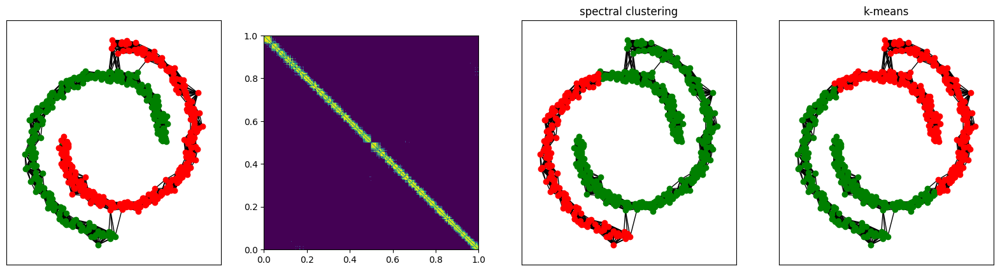

two_moons - KNN OR graph - k = 20


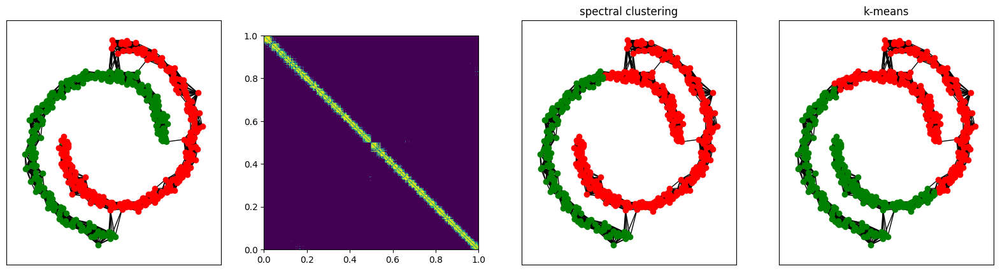

In [34]:
all_k = np.arange(10, 21)
all_spectral_score = []
all_kmeans_score = []

for k in all_k:
    print(f"{str(two_moons.__name__)} - KNN OR graph - k = {k}")
    W = build_similarity_graph(X, var=1, k=k, knn_or=True)
    spectral_score, kmeans_score = clustering_and_plot(X, Y, W, num_classes=num_classes)
    all_spectral_score.append(spectral_score)
    all_kmeans_score.append(kmeans_score)

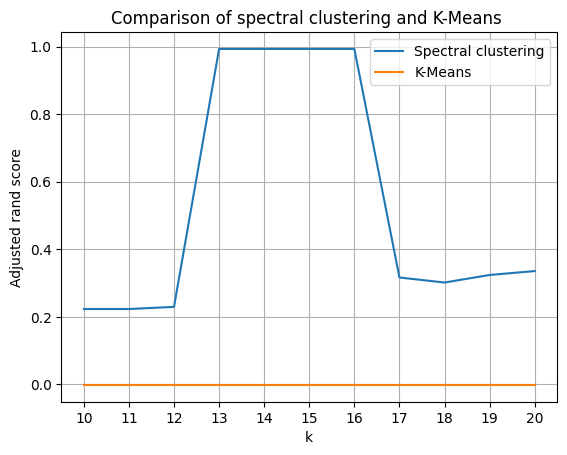

In [35]:
plt.figure()
plt.plot(np.arange(len(all_k)), all_spectral_score, label="Spectral clustering")
plt.plot(np.arange(len(all_k)), all_kmeans_score, label="K-Means")
plt.title(f"Comparison of spectral clustering and K-Means ")
plt.xticks(np.arange(len(all_k)), all_k)
plt.grid(True)
plt.xlabel("k")
plt.ylabel("Adjusted rand score")
plt.legend()
plt.show()

two_moons - Epsilon graph - eps = 0.50


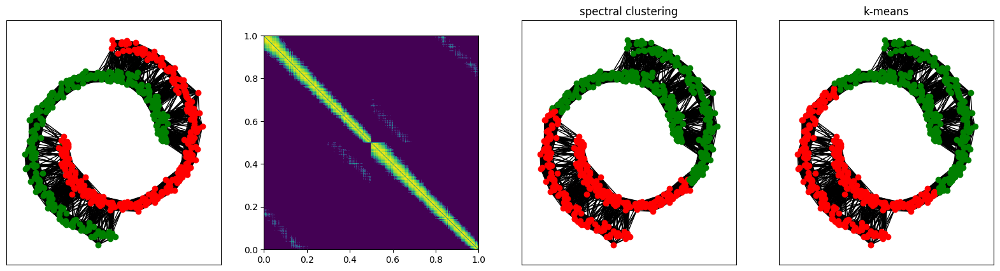

two_moons - Epsilon graph - eps = 0.55


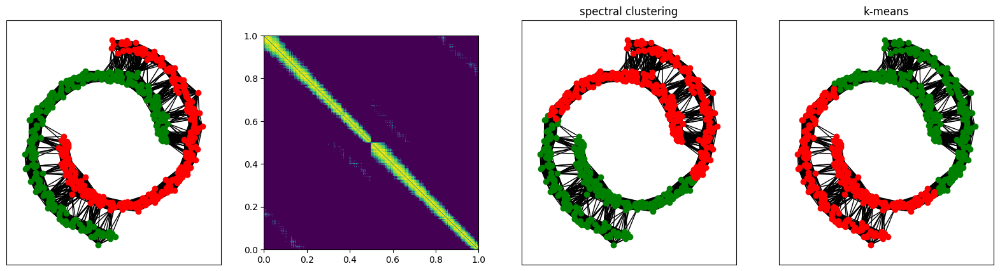

two_moons - Epsilon graph - eps = 0.60


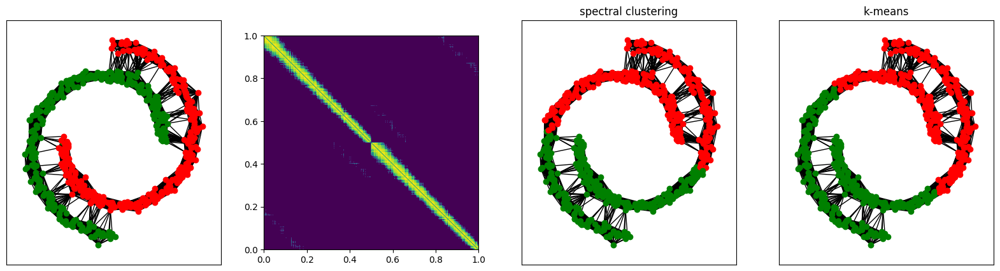

two_moons - Epsilon graph - eps = 0.65


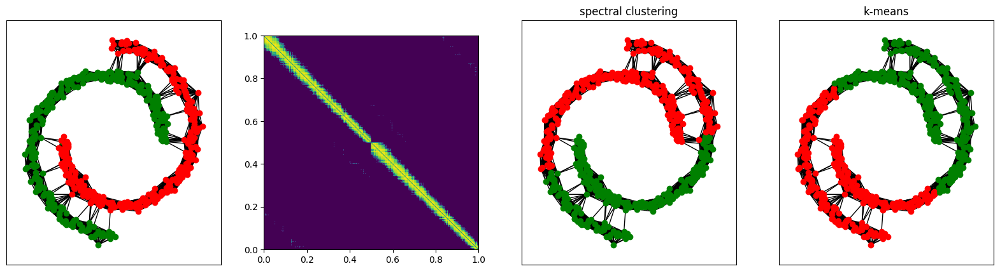

two_moons - Epsilon graph - eps = 0.70


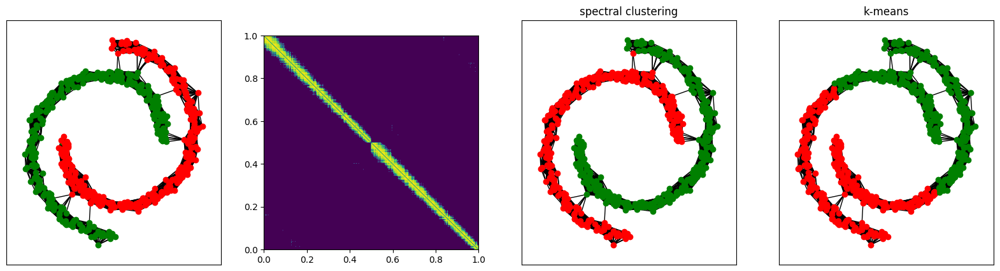

two_moons - Epsilon graph - eps = 0.75


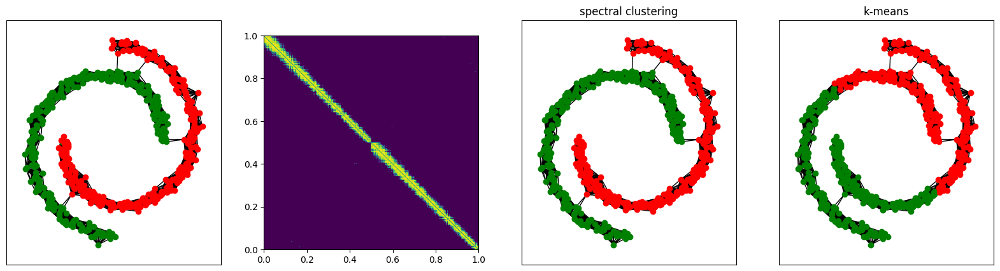

two_moons - Epsilon graph - eps = 0.80


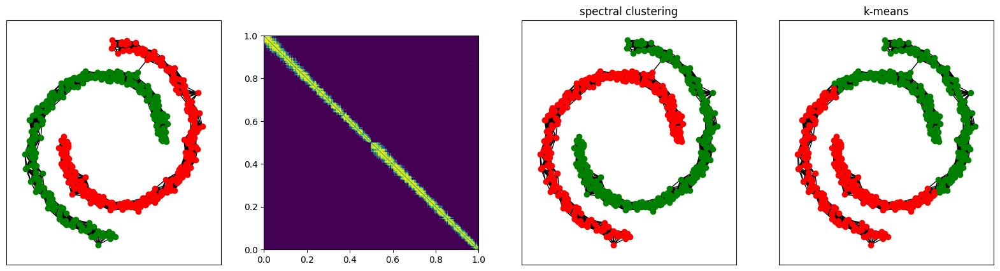

two_moons - Epsilon graph - eps = 0.85


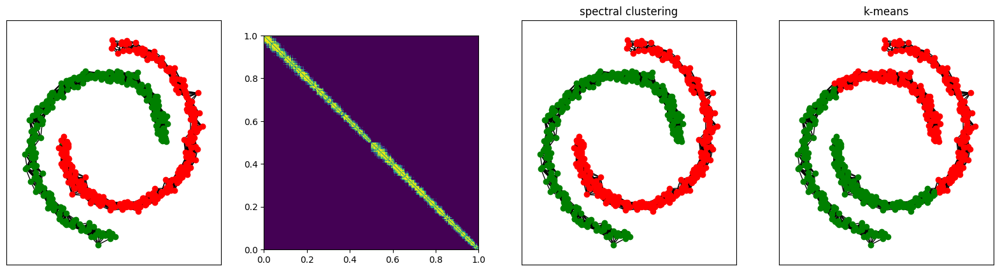

two_moons - Epsilon graph - eps = 0.90


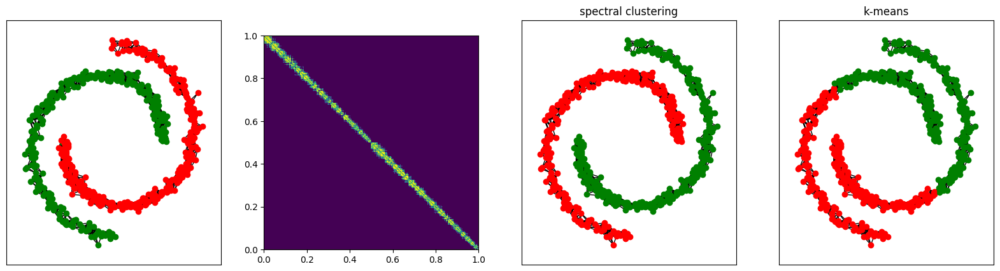

two_moons - Epsilon graph - eps = 0.95


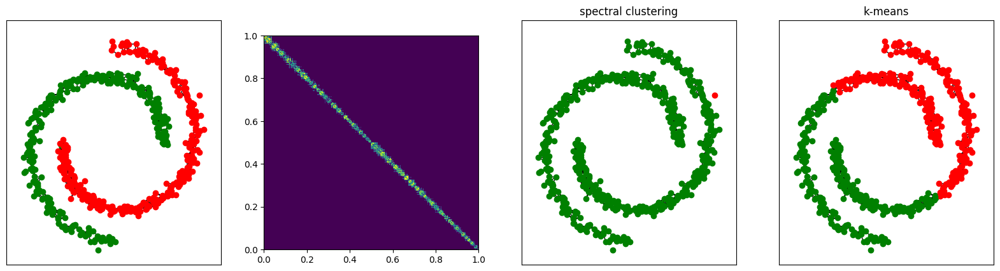

In [36]:
all_eps = np.arange(0.5, 1.0, 0.05)
all_spectral_score = []
all_kmeans_score = []

for eps in all_eps:
    print(f"{str(two_moons.__name__)} - Epsilon graph - eps = {eps:.2f}")
    W = build_similarity_graph(X, var=1, eps=eps)
    spectral_score, kmeans_score = clustering_and_plot(X, Y, W, num_classes=num_classes)
    all_spectral_score.append(spectral_score)
    all_kmeans_score.append(kmeans_score)

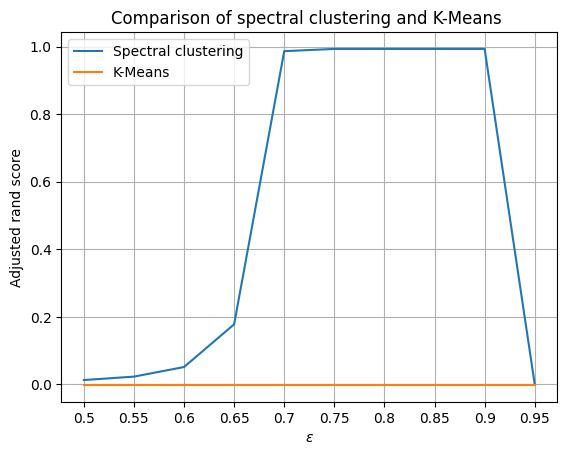

In [37]:
plt.figure()
plt.plot(np.arange(len(all_eps)), all_spectral_score, label="Spectral clustering")
plt.plot(np.arange(len(all_eps)), all_kmeans_score, label="K-Means")
plt.title(f"Comparison of spectral clustering and K-Means ")
plt.xticks(np.arange(len(all_eps)), np.round(all_eps, 2))
plt.grid(True)
plt.xlabel("$\epsilon$")
plt.ylabel("Adjusted rand score")
plt.legend()
plt.show()

### Q2.6: Generate `point_and_circle` data and compare spectral clustering using the normal Laplacian and the random-walk regularized Laplacian. Do you notice any difference? Taking into consideration the graph structure, can you explain them?

> We compared the clusterings obtained by spectral clustering on the unnormalized Laplacian and on the random walk Laplacian. We compare the two normalizations in the sense of the adjusted rand score, but also by displaying the induced clusterings. We use $\epsilon$-graphs for both normalizations, varying $\epsilon$.

> The `point_and_circle` dataset contains two clusters, one of which is nested within the other. Note that points from different clusters are sufficiently far apart in terms of distance, and therefore less similar in the sense of our similarity metric. For both normalization and small $\epsilon$ values (including small similarities, between different cluster points), we find that the induced clustering is not correct. However, the random walk normalization of the Laplacian has on average a higher adjusted rand score than the unnormalized Laplacian. We note that for large $\epsilon$ values, from around 0.5 upwards, which corresponds better to the dataset, both normalizations produce correct clusters.

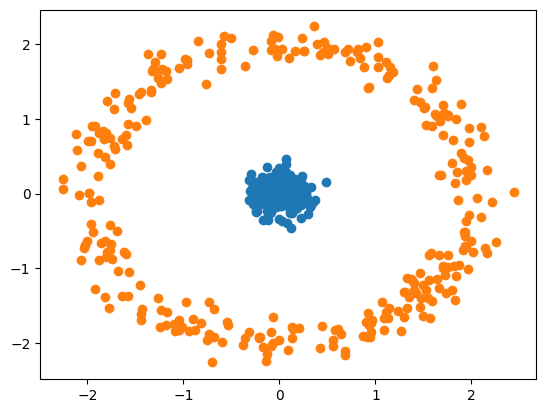

In [38]:
X, Y = point_and_circle(num_samples=600)
plot_clusters(X, Y)

Laplacian normalization = unn - Epsilon graph - eps = 0.3


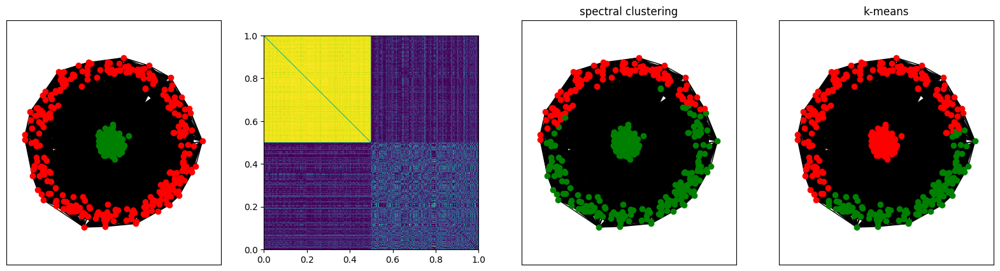

Laplacian normalization = rw - Epsilon graph - eps = 0.3


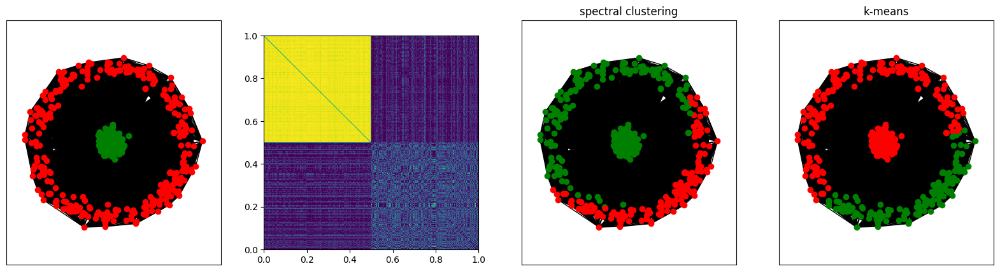

Laplacian normalization = unn - Epsilon graph - eps = 0.4


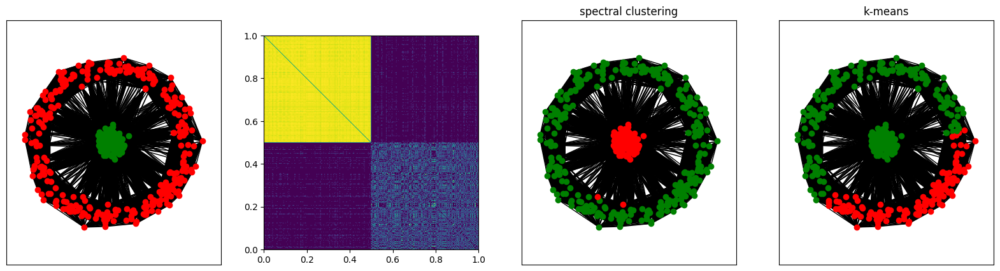

Laplacian normalization = rw - Epsilon graph - eps = 0.4


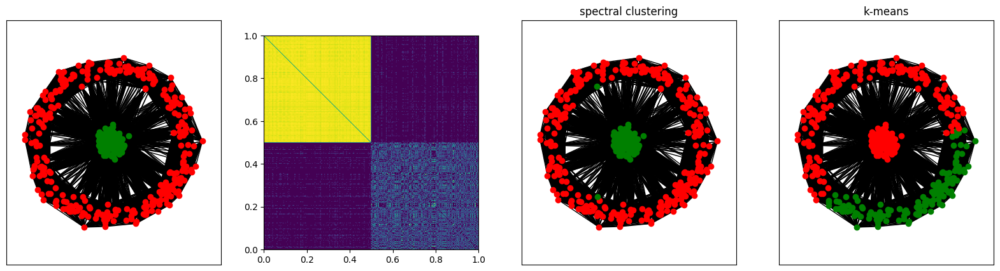

Laplacian normalization = unn - Epsilon graph - eps = 0.5


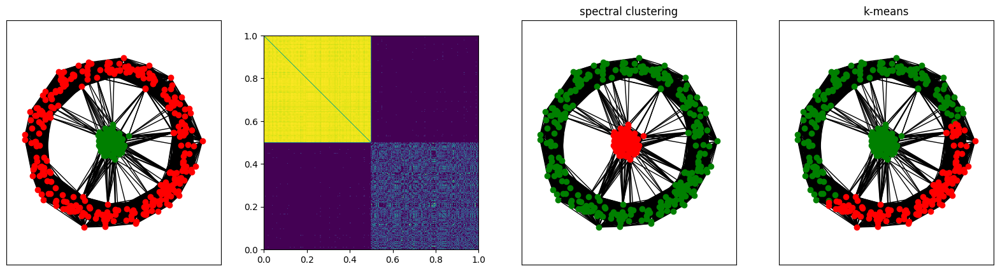

Laplacian normalization = rw - Epsilon graph - eps = 0.5


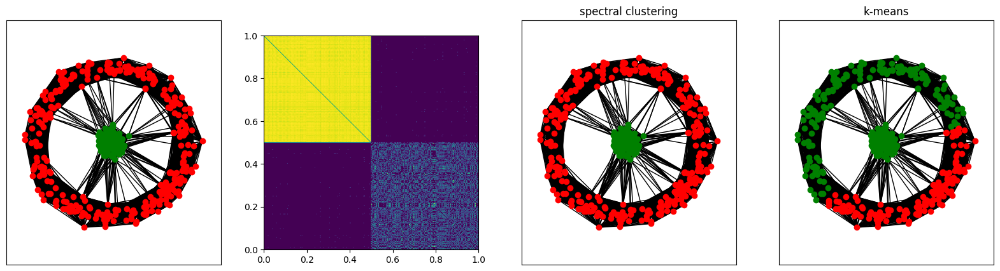

Laplacian normalization = unn - Epsilon graph - eps = 0.6


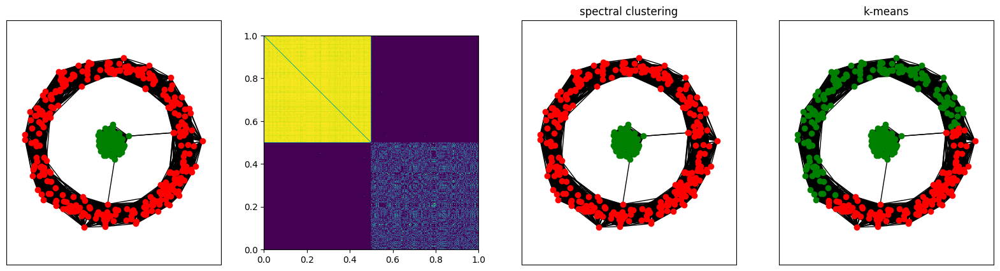

Laplacian normalization = rw - Epsilon graph - eps = 0.6


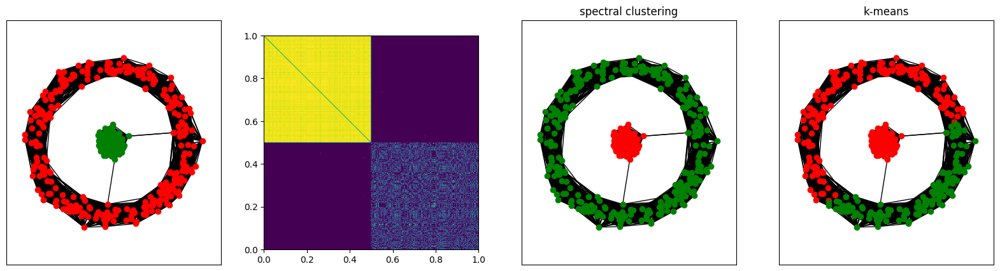

Laplacian normalization = unn - Epsilon graph - eps = 0.7


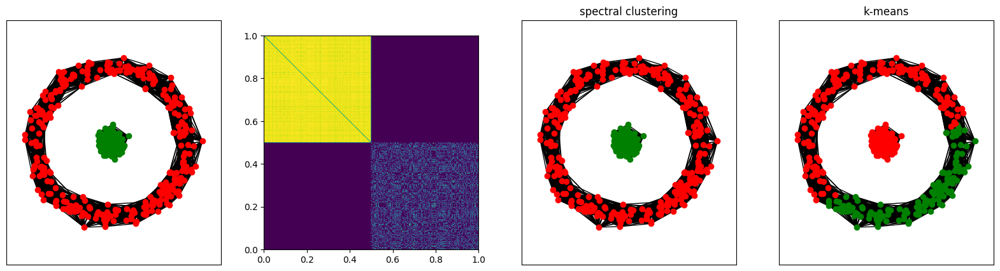

Laplacian normalization = rw - Epsilon graph - eps = 0.7


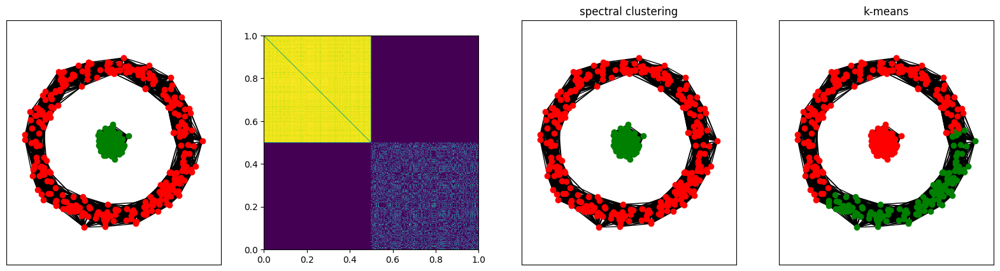

Laplacian normalization = unn - Epsilon graph - eps = 0.8


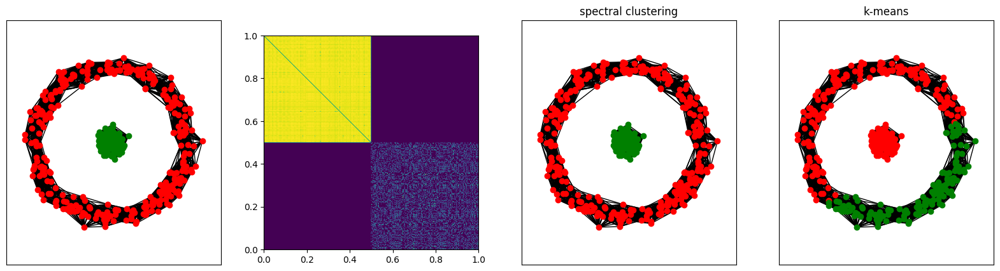

Laplacian normalization = rw - Epsilon graph - eps = 0.8


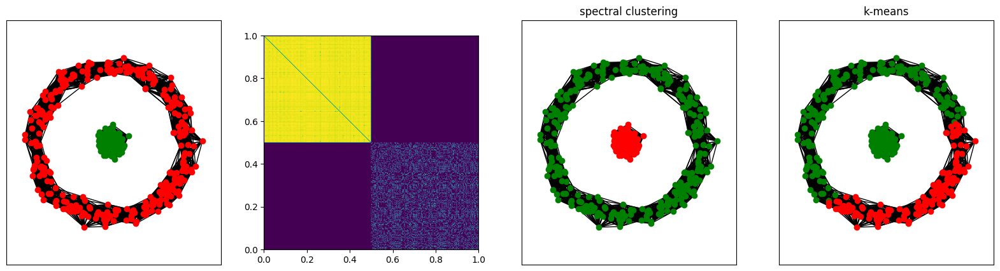

Laplacian normalization = unn - Epsilon graph - eps = 0.9


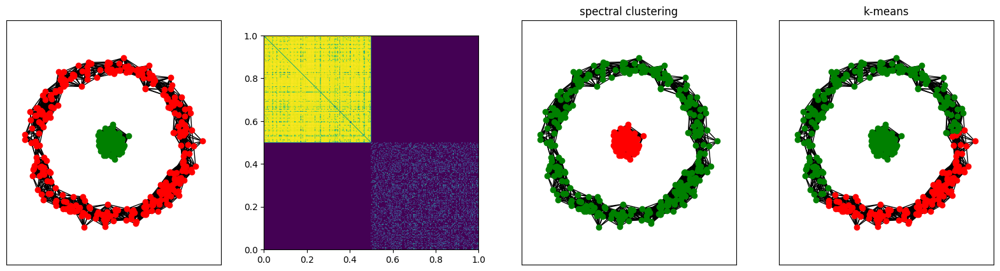

Laplacian normalization = rw - Epsilon graph - eps = 0.9


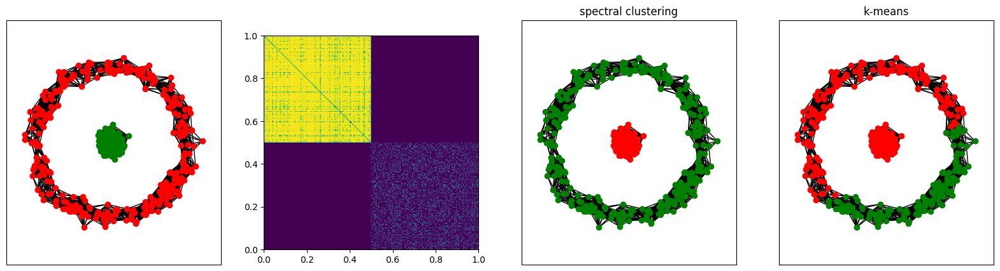

In [39]:
all_eps = np.arange(0.3, 1.0, 0.1)
all_unn_score = []
all_rw_score = []

for eps in all_eps:

    W = build_similarity_graph(X, var=1.44, eps=eps)
    
    for laplacian_normalization in ['unn', 'rw']:
        print(f"Laplacian normalization = {laplacian_normalization} - Epsilon graph - eps = {eps:.1f}")
        spectral_score, _ = clustering_and_plot(
            X, Y, W, 
            num_classes=num_classes, 
            laplacian_normalization=laplacian_normalization
        )
        if laplacian_normalization == 'unn':
            all_unn_score.append(spectral_score)
        else:
            all_rw_score.append(spectral_score)

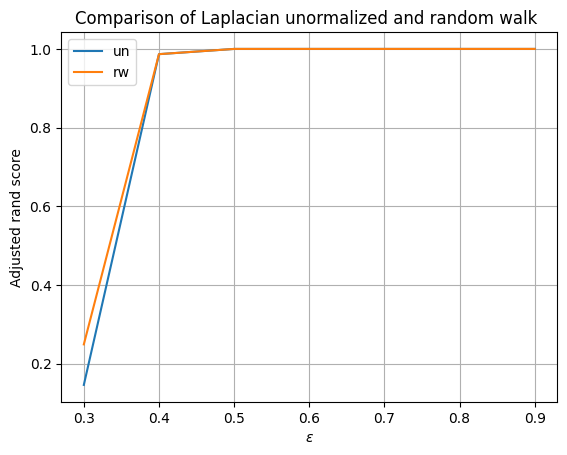

In [40]:
plt.figure()
plt.plot(np.arange(len(all_eps)), all_unn_score, label="un")
plt.plot(np.arange(len(all_eps)), all_rw_score, label="rw")
plt.title(f"Comparison of Laplacian unormalized and random walk ")
plt.xticks(np.arange(len(all_eps)), np.round(all_eps, 1))
plt.grid(True)
plt.xlabel("$\epsilon$")
plt.ylabel("Adjusted rand score")
plt.legend()
plt.show()

### Q2.7: Using the function parameter_sensitivity, comment on the stability of spectral clustering when varying $\epsilon$ or k. 

> Here we study the sensitivity to the hyper-parameters $\epsilon$ for the $\epsilon$-graph and $k$ for the K-NN graph, for the three Laplacian normalizations on the `two_moons` dataset. We vary $\epsilon$ between 0.4 and 1.0 excluded and vary $k$ between $1$ and $70$, and report the adjusted rand score for each hyper-parameter and each Laplacian normalization. Note that the choice of hyper-parameters that maximize the adjusted rand score depends on the dataset used.

> The results show that the spectral clustering result is highly dependent on the hyper-parameters chosen, and also varies for different Laplacian normalizations. 

> Note that, in the case of the $\epsilon$-graph, including small similarities does not result in correct clustering on average. You need to choose the right similarity threshold to be able to easily distinguish the clusters in the dataset used.

> Note that, in the case of the K-NN graph, the results also change depending on whether a K-NN graph OR or a K-NN graph AND is used. The K-NN graph AND needs a $k$ value large enough to obtain a graph similar to the KNN-graph OR. For both possibilities, the clustering results vary enormously with the $k$ value chosen, the dataset and the normalization. For our dataset, very small $k$ values (less than 5 for the OR case and 10 for the AND case) and very large ones (greater than 20 for the OR case and 50 for the AND case) fail to reproduce correct clustering. It should be noted that, depending on the dataset, results may vary even within the same interval of values.

> These results allow us to conclude that spectral clustering is very sensitive to the choice of hyper-parameters.

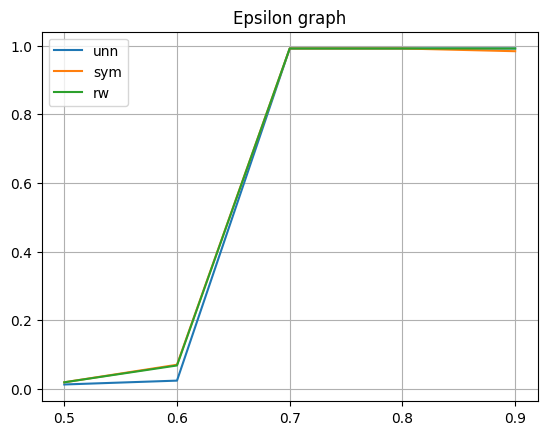

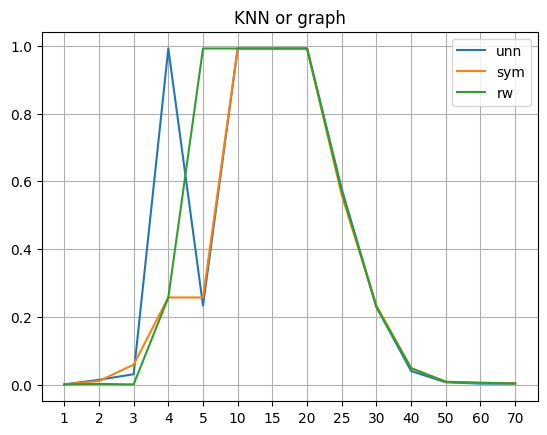

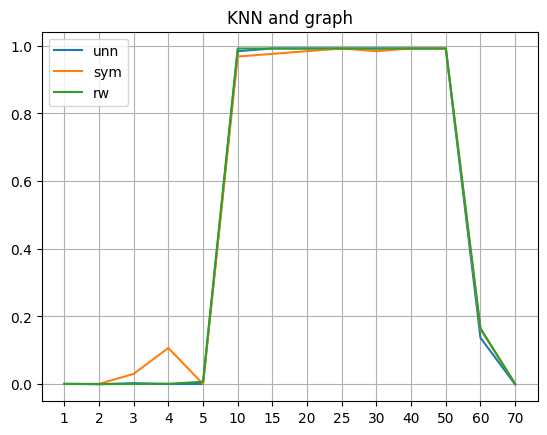

In [41]:
_ = parameter_sensitivity()

### Q2.8: If we did not have access to "true" labels, how could we evaluate the clustering result (or what should we not use as evaluation)?

> `Modularity`: Evaluates the quality of a partition in a network by comparing the number of edges within clusters to the expected number in a random graph.

> `Silhouette Score`: Measures how well-separated clusters are. A higher silhouette score indicates better-defined clusters.

> `Davies-Bouldin Index`: Measures the compactness and separation between clusters. A lower index indicates better clustering.

> `Inertia (or Sum of Squared Distances)`: Measures the compactness of clusters. It is the sum of squared distances between each point and the centroid of its assigned cluster. Lower inertia suggests more compact clusters.

> `Connectivity, Compactness, and Separation (CCS)`: Measures the quality of a clustering solution by assessing connectivity within clusters, compactness of clusters, and separation between clusters.

> `Hopkins Statistic`: Measures the tendency of data points to cluster together. A higher Hopkins statistic suggests a higher likelihood of clustering.

> `Visualization Techniques`: Utilize dimensionality reduction and visualization techniques (e.g., t-SNE, PCA) to visually inspect the clusters. While not quantitative, visual examination can provide insights into the clustering structure.

> `Stability-based Approaches`: Perform clustering multiple times and assess the stability of the results across runs. Consensus clustering methods analyze the consistency of assignments across different runs.

`Modularity`: $$ Q = \frac{1}{2m} \sum_{ij} \bigg(W_{ij} - \frac{k_ik_j}{2m}\bigg) \delta(c_i, c_j)$$ where: 
- $W_{ij}$ is the weight of the edge between nodes i and j,
- $k_i$ and $k_j$ are the degrees of nodes i and j (sum of weights of edges connected to i and j),
- $m$ is the sum of all edge weights in the network,
- $\delta(c_i, c_j)$ is 1 if node i and j are in the same cluster (have the same label) and 0 otherwise.

In [42]:
def modularity(W, labels):
    n = len(W)
    m = np.sum(W) / 2

    modularity = 0.0
    for i in range(n):
        ki = np.sum(W[i, :])
        for j in range(n):
            kj = np.sum(W[j, :])
            modularity += (W[i, j] - (ki * kj) / (2 * m)) * (labels[i] == labels[j])

    modularity /= (2 * m)
    return modularity

### Q3.1: Complete all the code necessary, and cluster the `four_elements` and `fruit_salad` images in the data folder and include here some images of the clustering.  Explain your design choices in the overall pipeline (e.g. which graph, which pre-processing...) and how you think they impact the results you are seeing. Report also at least one failure mode for the algorithm.

Four elements succes


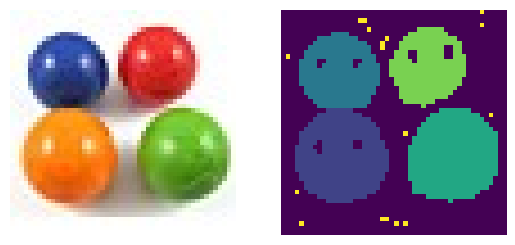

Four elements fail


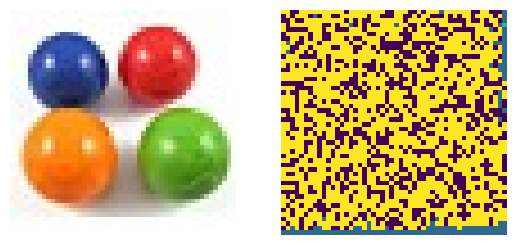

In [43]:
print("Four elements succes")
image_segmentation(
    input_img='four_elements.bmp',
    eps=eps, var=1, k=11, knn_or=True,
    laplacian_normalization='rw', 
    num_classes=6, chosen_eig_indices=None
)

print("Four elements fail")
image_segmentation(
    input_img='four_elements.bmp',
    eps=eps, var=1, k=18, knn_or=True,
    laplacian_normalization='rw', 
    num_classes=6, chosen_eig_indices=None
)

> 

Espilon graph : eps = 0.1


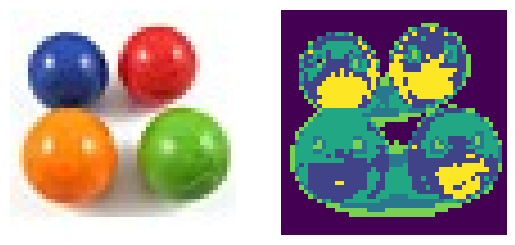

Espilon graph : eps = 0.2


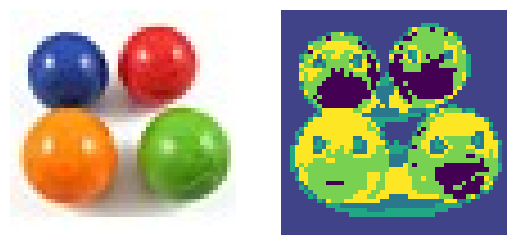

Espilon graph : eps = 0.3


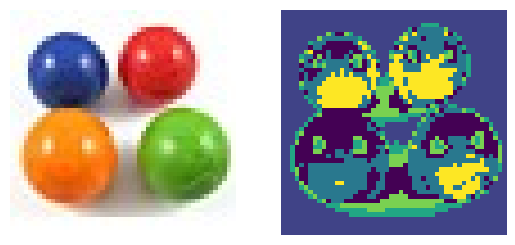

Espilon graph : eps = 0.4


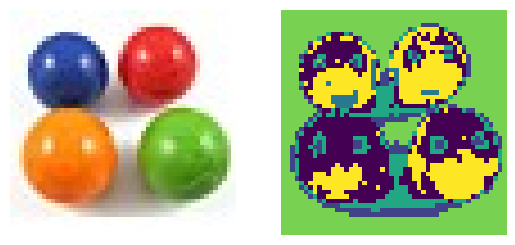

Espilon graph : eps = 0.5


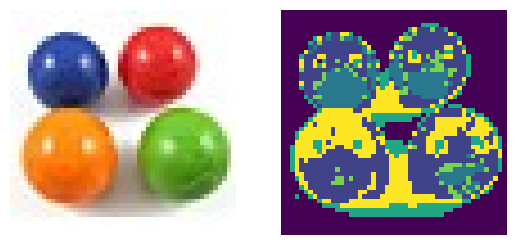

Espilon graph : eps = 0.6


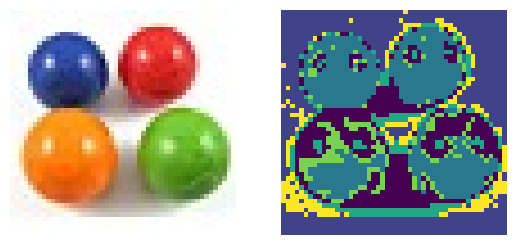

Espilon graph : eps = 0.7


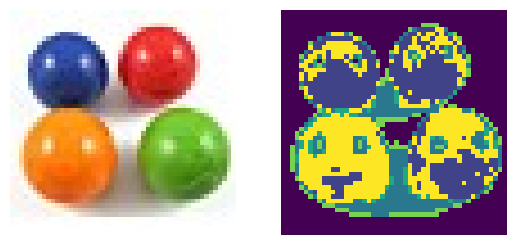

Espilon graph : eps = 0.8


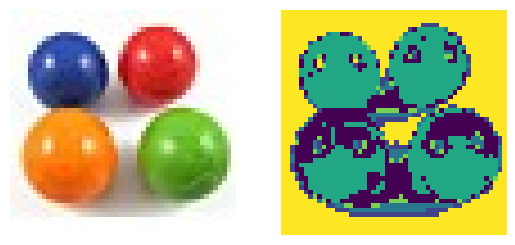

Espilon graph : eps = 0.9


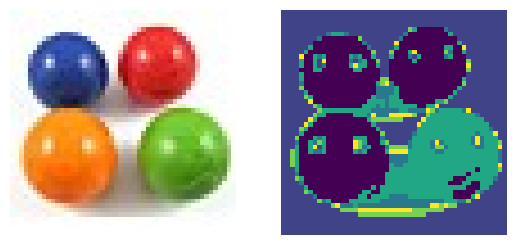

In [45]:
for eps in np.arange(0.1, 1, 0.1):
    print(f"Espilon graph : eps = {eps:.1F}")
    image_segmentation(
        input_img='four_elements.bmp',
        eps=eps, var=1, k=0, knn_or=True,
        laplacian_normalization='rw', 
        num_classes=6, chosen_eig_indices=None
    )

KNN or graph : k = 10


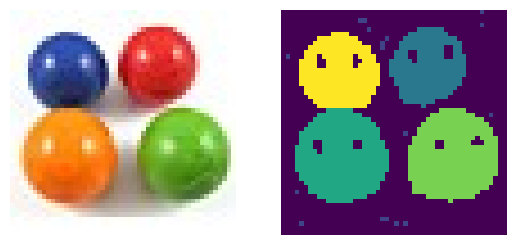

KNN or graph : k = 11


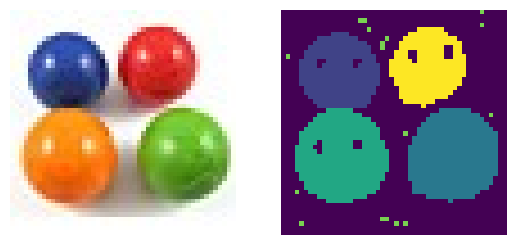

KNN or graph : k = 12


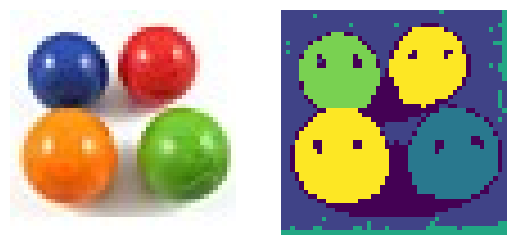

KNN or graph : k = 13


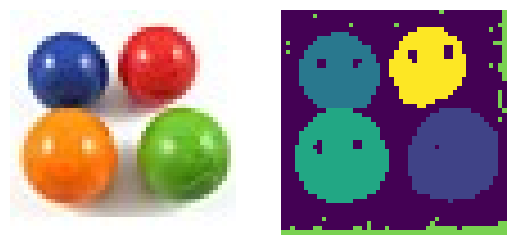

KNN or graph : k = 14


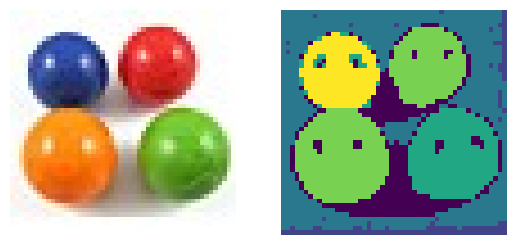

KNN or graph : k = 15


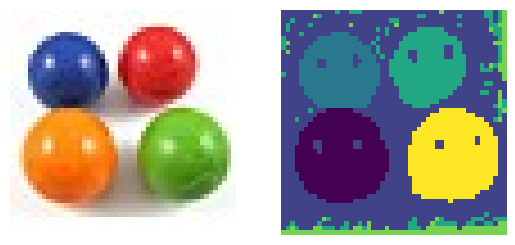

KNN or graph : k = 16


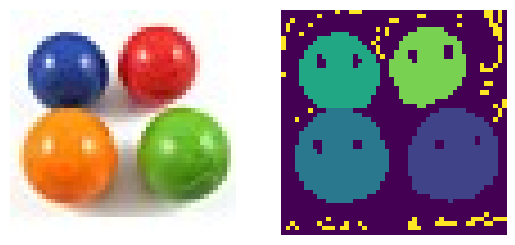

KNN or graph : k = 17


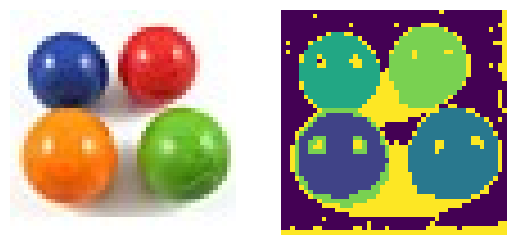

KNN or graph : k = 18


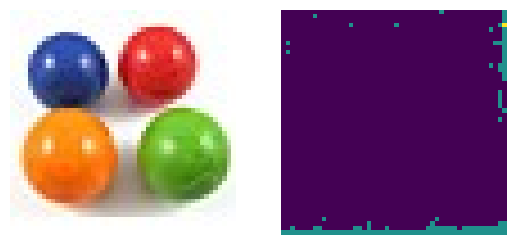

KNN or graph : k = 19


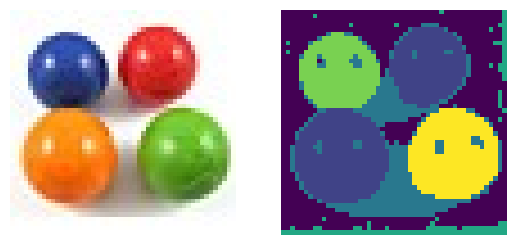

In [46]:
for k in range(10, 20):
    print(f"KNN or graph : k = {k}")
    image_segmentation(
        input_img='four_elements.bmp',
        eps=0, var=1, k=k, knn_or=True,
        laplacian_normalization='rw', 
        num_classes=6, chosen_eig_indices=None
    )

KNN or graph : k = 10


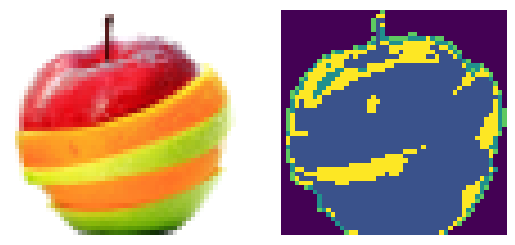

KNN or graph : k = 11


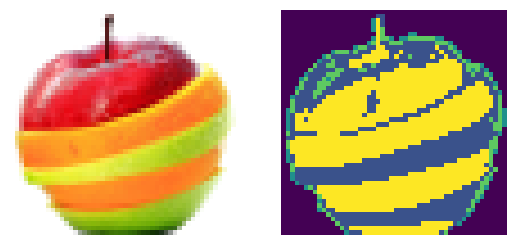

KNN or graph : k = 12


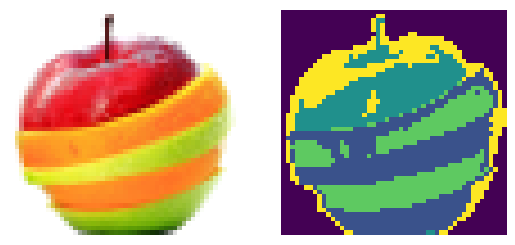

KNN or graph : k = 13


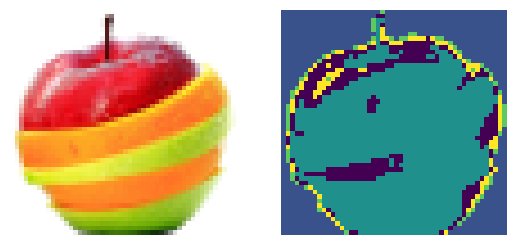

KNN or graph : k = 14


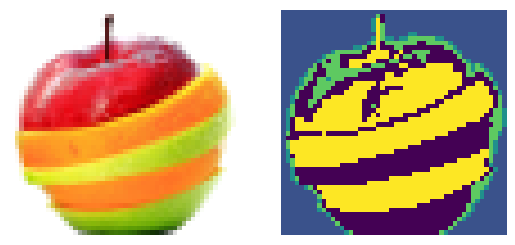

KNN or graph : k = 15


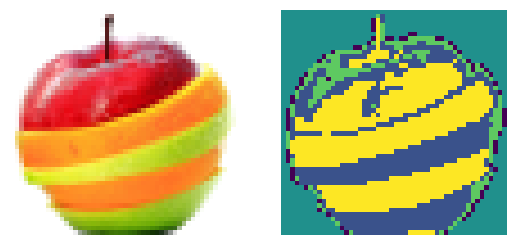

KNN or graph : k = 16


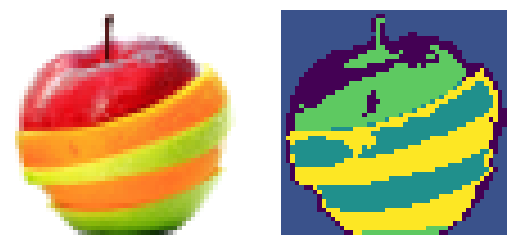

KNN or graph : k = 17


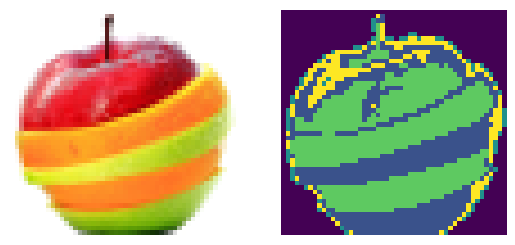

KNN or graph : k = 18


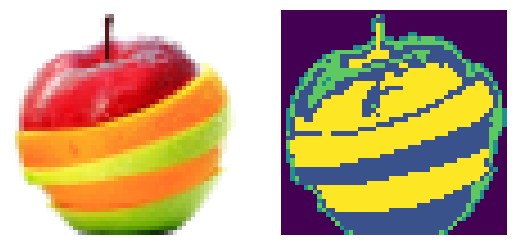

KNN or graph : k = 19


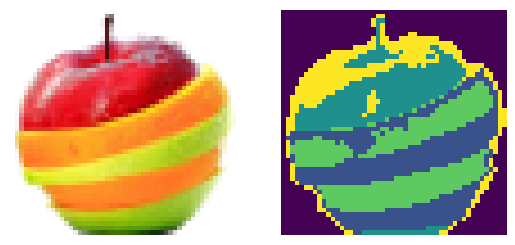

KNN or graph : k = 20


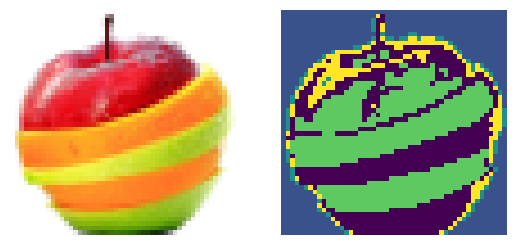

KNN or graph : k = 21


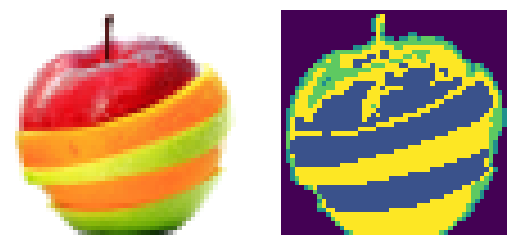

KNN or graph : k = 22


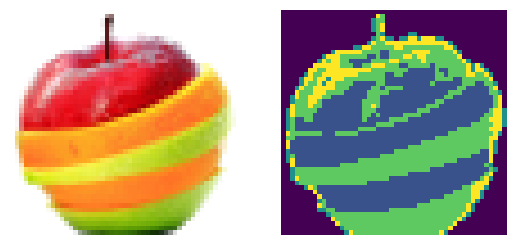

KNN or graph : k = 23


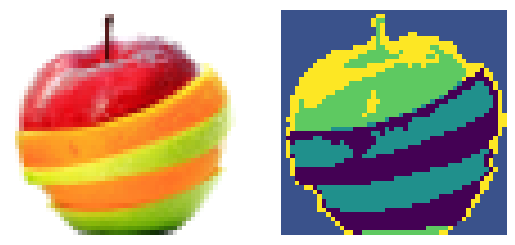

KNN or graph : k = 24


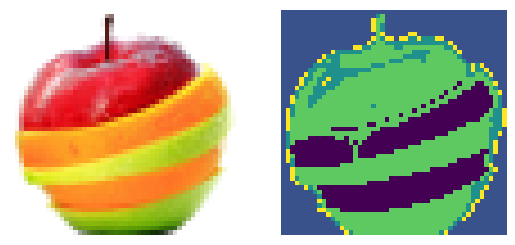

KNN or graph : k = 25


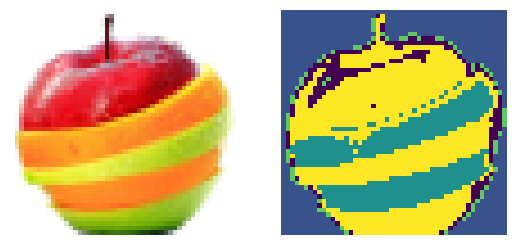

KNN or graph : k = 26


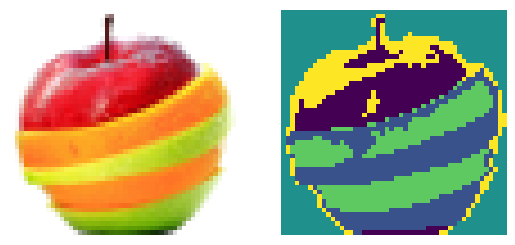

KNN or graph : k = 27


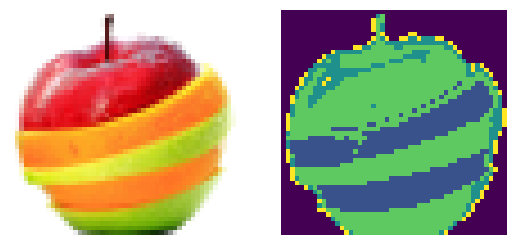

KNN or graph : k = 28


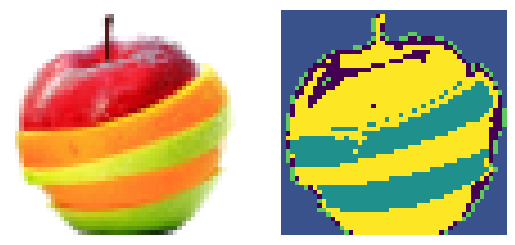

KNN or graph : k = 29


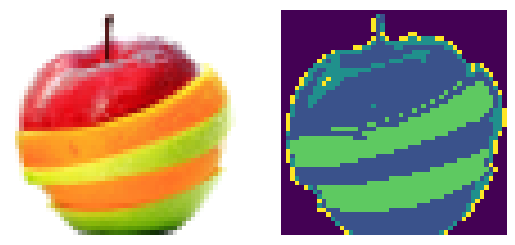

In [47]:
for k in range(10, 30):
    print(f"KNN or graph : k = {k}")
    image_segmentation(
        input_img='fruit_salad.bmp',
        eps=0, var=1.44, k=k, knn_or=True,
        laplacian_normalization='rw', 
        num_classes=5, chosen_eig_indices=None
    )

### Q3.2: A full graph built between the pixels of a 50 × 50 image corresponds to $50^2$ nodes. Solving the full eigenvalue problem in this case would scale in the order of $2^{34}$ . Even on weak hardware this takes only seconds to minutes. Segmenting a Full HD picture of 1920 × 1080 would scale in the order of $2^{64}$ (about a month on a decent machine). Beyond that, the large picture would require to store in memory a graph over millions of nodes. A full graph on that scale requires about 1TB of memory. Can you think two simple techniques to reduce the computational and occupational cost of Spectral Clustering?

`Technique 1`:
- Generate super-pixels, groups of pixels with similar characteristics, using the SLIC method, for example.
- Each pixel group is used as a node in the new graph. 
- Clustering is applied to the new graph.

`Technique 2`:
- Subsample the image before clustering.
- With a segmented version of the downsampled image, upsample to match the size of the segmented image to that of the original image. 
- To smooth the segmentation, we can add image filtering or morphological methods.
- Clustering is applied to the new image.

### Q3.3: Choose a larger image of your choice, and try to implement some of the scalability modifications to run spectral clustering on it. Report some examples of the results you achieve. 

(1059, 1800, 3)


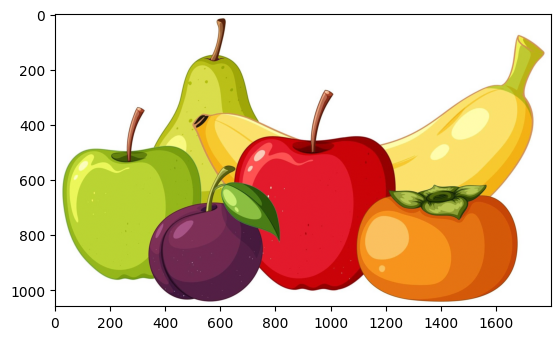

In [48]:
filename = 'data/fruit2.jpeg'
image = io.imread(filename)[:,:,:3]
X = (image - np.min(image)) / (np.max(image) - np.min(image))
print(X.shape)
plt.imshow(X)
plt.show()

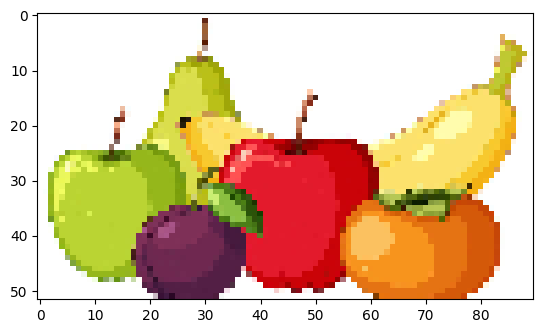

In [49]:
w, h, c = X.shape

scale = 20
image_rescale = np.zeros((w // scale, h // scale, c))

for i in range(0, w, scale):
    for j in range(0, h, scale):
        try:
            image_rescale[i // scale, j // scale] = X[i, j]
        except IndexError:
            pass

plt.imshow(image_rescale)
plt.show()

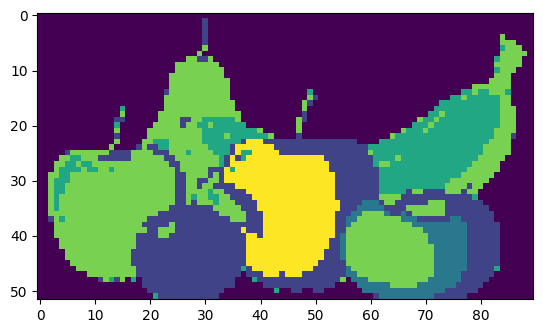

In [57]:
num_classes = 6

W = build_similarity_graph(image_rescale.reshape(-1, 3), var=1, k=22)
L = build_laplacian(W)
spectral_label = spectral_clustering(L, None, num_classes=num_classes)
spectral_label = spectral_label.reshape(w // scale, h // scale)

plt.imshow(spectral_label)
plt.show()

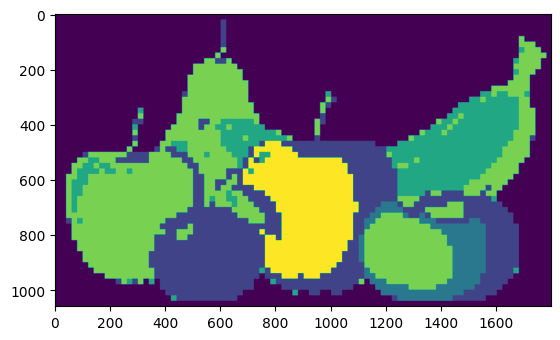

In [58]:
hat_image = np.zeros((w, h))

for i in range(0, w - scale, scale):
    for j in range(0, h - scale, scale):      
        hat_image[i, j] = spectral_label[i // scale][j // scale]

for i in range(1, w- (scale - 1), scale):
    for j in range(0, h - (scale - 1)):
        hat_image[i: i + (scale - 1), j] = hat_image[i - 1, j]

for i in range(0, w - 1):
    for j in range(1, h - 1, scale):
        hat_image[i, j: j + (scale - 1)] = hat_image[i, j - 1]

plt.imshow(hat_image)
plt.show()

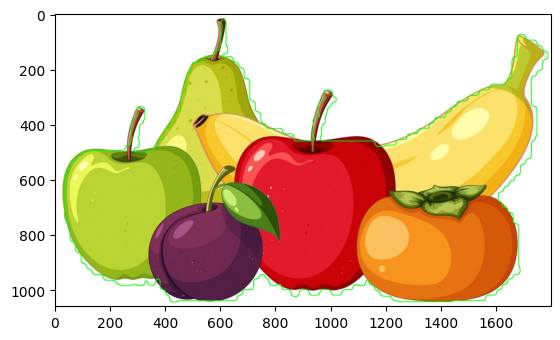

In [59]:
import cv2
tmp_image = cv2.GaussianBlur(hat_image.astype(np.uint8), (35, 35), 0)
contours,_ = cv2.findContours(tmp_image, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
image_contours = cv2.drawContours(image.astype(np.uint8) , contours, -1, (0, 255, 0), 2)
plt.imshow(image_contours)
plt.show()